<a href="https://colab.research.google.com/github/anesum99/cs131_notes_dev/blob/master/cheng2020.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [35]:
!pip install compressai

In [60]:
import math
import io
import os
import torch
from torchvision import transforms
import numpy as np

from PIL import Image

import matplotlib.pyplot as plt

import torchvision.transforms as transforms

In [37]:
from pytorch_msssim import ms_ssim

In [38]:
from compressai.zoo import (cheng2020_anchor, cheng2020_attn)


In [39]:
from ipywidgets import interact, widgets

## Global settings

In [40]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
# metric = 'mse'  # only pre-trained model for mse are available for now
# quality = 1     # lower quality -> lower bit-rate (use lower quality to clearly see visual differences in the notebook)

## Loading pretrained models

In [42]:
net = cheng2020_anchor(quality=3, pretrained=True).eval().to(device)

Downloading: "https://compressai.s3.amazonaws.com/models/v1/cheng2020-anchor-3-e49be189.pth.tar" to /root/.cache/torch/hub/checkpoints/cheng2020-anchor-3-e49be189.pth.tar
100%|██████████| 49.1M/49.1M [00:01<00:00, 32.9MB/s]


In [43]:
networks = {
    # 'bmshj2018-factorized': bmshj2018_factorized(quality=quality, pretrained=True).eval().to(device),
    # 'bmshj2018-hyperprior': bmshj2018_hyperprior(quality=quality, pretrained=True).eval().to(device),
    # 'mbt2018-mean': mbt2018_mean(quality=quality, pretrained=True).eval().to(device),
    # 'mbt2018': mbt2018(quality=quality, pretrained=True).eval().to(device),
    'cheng2020-anchor': cheng2020_anchor(quality=quality, pretrained=True).eval().to(device),
    'cheng2020-attn': cheng2020_attn(quality=quality, pretrained=True).eval().to(device)
}

In [44]:
print(f'Parameters: {sum(p.numel() for p in net.parameters())}')

Parameters: 11833149


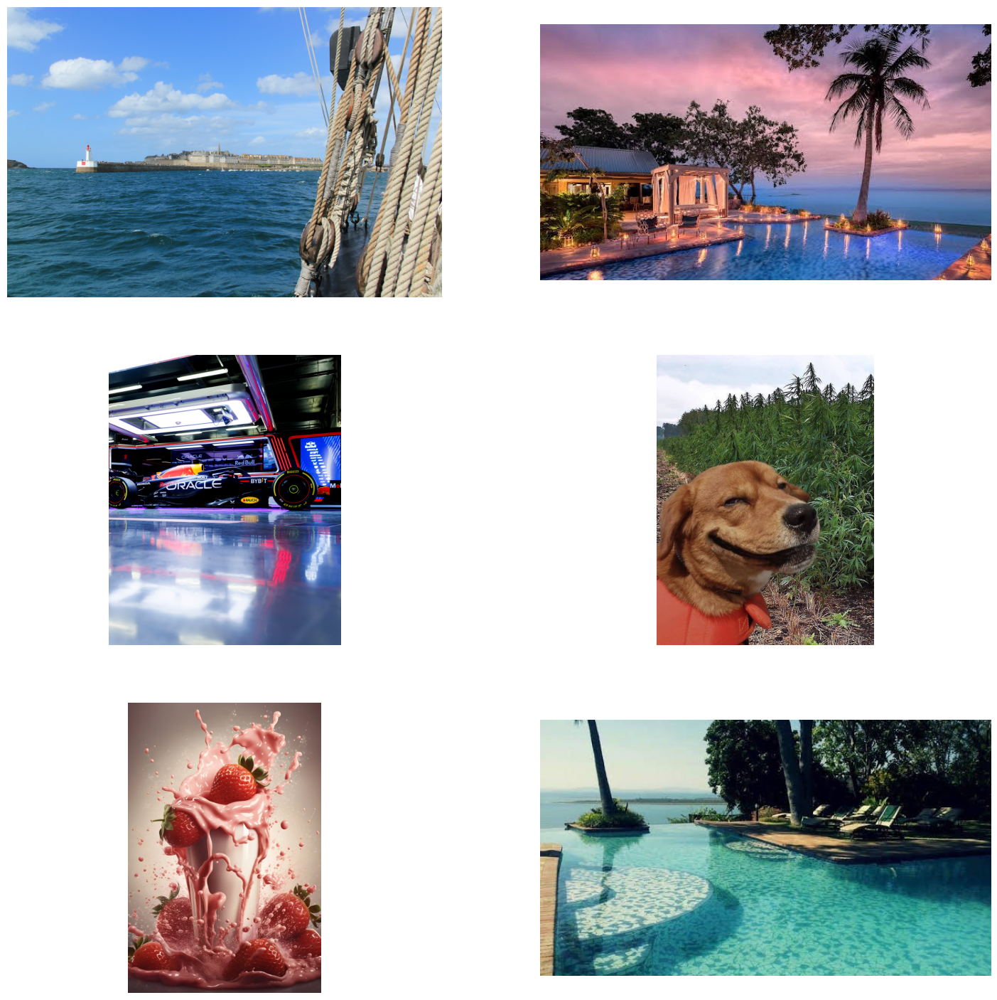

In [106]:
# Directory containing the images
input_dir = './input_images'

# Define the transform
resize_transform = transforms.Compose([
    transforms.Resize((512, 768)),
    transforms.ToTensor()
])

# Get a list of all image files in the specified directory
image_files = [f for f in os.listdir(input_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]

# Determine the number of rows needed for the subplots
num_rows = len(image_files) // 2 + len(image_files) % 2

# Create a figure for the subplots
plt.figure(figsize=(18, 6 * num_rows))
#collection of the loaded images
image_tensors = []
# Loop through each image file, with a step of 2 to process images in pairs
for i in range(0, len(image_files), 2):
    # Construct the full path to the first image file in the pair
    image_path1 = os.path.join(input_dir, image_files[i])

    # Open the first image file
    img1 = Image.open(image_path1).convert('RGB')
    tensor1 = resize_transform(img1).unsqueeze(0).to(device)
    image_tensors.append(tensor1)

    # Create a subplot for the first image in the pair
    plt.subplot(num_rows, 2, i + 1)
    plt.axis('off')
    plt.imshow(img1)

    # If there's a second image in the pair, process and display it
    if i + 1 < len(image_files):
        # Construct the full path to the second image file in the pair
        image_path2 = os.path.join(input_dir, image_files[i + 1])

        # Open the second image file
        img2 = Image.open(image_path2).convert('RGB')
        tensor2 = resize_transform(img2).unsqueeze(0).to(device)
        image_tensors.append(tensor2)
        # Create a subplot for the second image in the pair
        plt.subplot(num_rows, 2, i + 2)
        plt.axis('off')
        plt.imshow(img2)

# Display the figure with all subplots
plt.show()

## Run the networks

In [66]:
outputs = []

with torch.no_grad():
    for x in image_tensors:
        out_net = net.forward(x)
        out_net['x_hat'].clamp_(0, 1)
        outputs.append(out_net)

# Now, 'outputs' is a list where each element is the output for the corresponding tensor in 'xs'
for i, out_net in enumerate(outputs):
    print(f'Output for tensor {i}:')
    print(out_net.keys())



Output for tensor 0:
dict_keys(['x_hat', 'likelihoods'])
Output for tensor 1:
dict_keys(['x_hat', 'likelihoods'])
Output for tensor 2:
dict_keys(['x_hat', 'likelihoods'])
Output for tensor 3:
dict_keys(['x_hat', 'likelihoods'])
Output for tensor 4:
dict_keys(['x_hat', 'likelihoods'])
Output for tensor 5:
dict_keys(['x_hat', 'likelihoods'])


### Visualize
Converting the Tensor back to a 2D Pillow image:

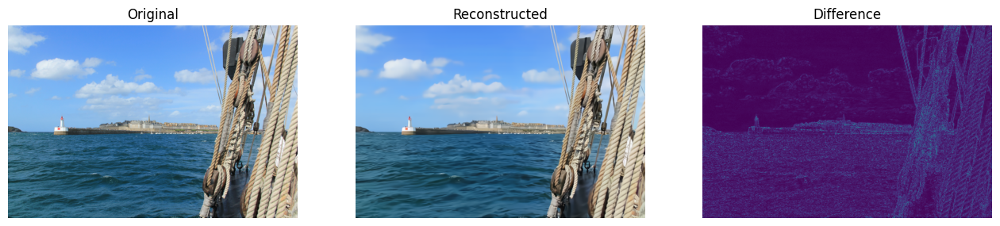

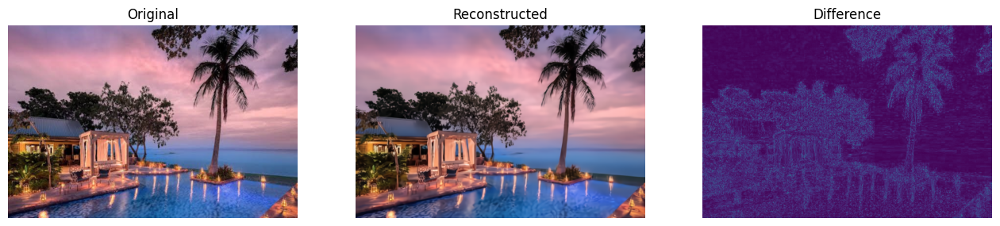

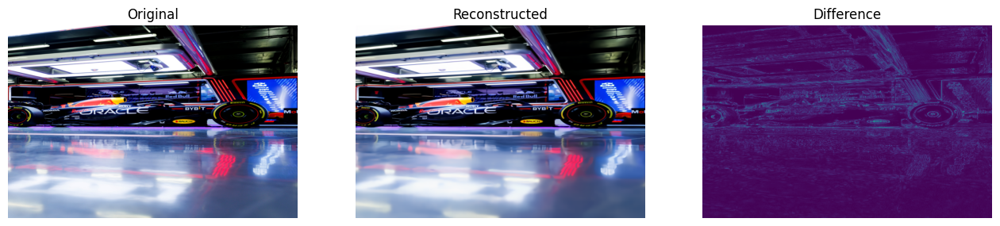

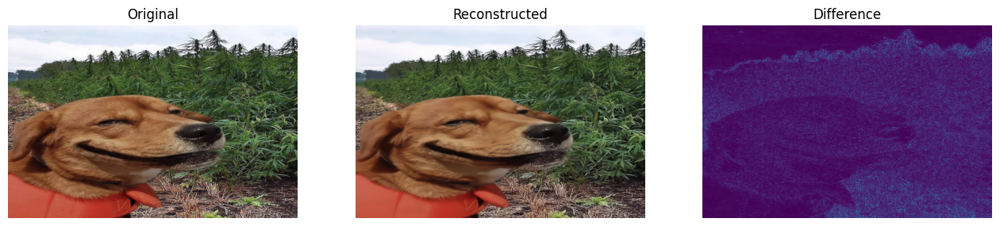

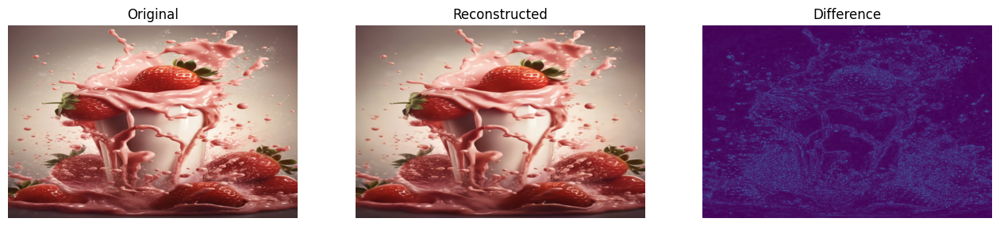

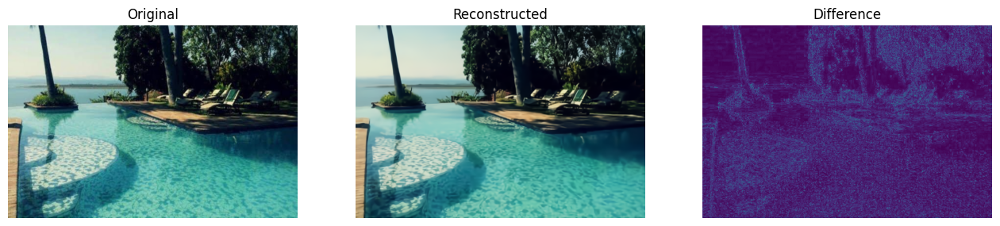

In [112]:
%matplotlib inline
rec_netlist = []
for i, out_net in enumerate(outputs):
    # Get the original image tensor (assuming image_tensors[i] corresponds to out_net)
    x = image_tensors[i]
    img = transforms.ToPILImage()(x.squeeze().cpu())  # Convert tensor to PIL Image

    # Convert the reconstructed tensor to a PIL Image
    rec_net = transforms.ToPILImage()(out_net['x_hat'].squeeze().cpu())
    rec_netlist.append(rec_net)
    # Compute the difference tensor
    diff = torch.mean((out_net['x_hat'] - x).abs(), axis=1).squeeze().cpu()

    # Create a new figure for each set of images
    fig, axes = plt.subplots(1, 3, figsize=(16, 12))
    for ax in axes:
        ax.axis('off')

    # Display the original, reconstructed, and difference images
    axes[0].imshow(img)
    axes[0].title.set_text('Original')

    axes[1].imshow(rec_net)
    axes[1].title.set_text('Reconstructed')

    axes[2].imshow(diff, cmap='viridis')
    axes[2].title.set_text('Difference')

    plt.show()

### **Compute metrics**
Now, let's compute some common metrics...

In [68]:
def compute_psnr(a, b):
    mse = torch.mean((a - b)**2).item()
    return -10 * math.log10(mse)

def compute_msssim(a, b):
    return ms_ssim(a, b, data_range=1.).item()

def compute_bpp(out_net):
    size = out_net['x_hat'].size()
    num_pixels = size[0] * size[2] * size[3]
    return sum(torch.log(likelihoods).sum() / (-math.log(2) * num_pixels)
              for likelihoods in out_net['likelihoods'].values()).item()

In [100]:
for i, out_net in enumerate(outputs):
    # Get the original image tensor (assuming image_tensors[i] corresponds to out_net)
    x = image_tensors[i]
    print(f'\t\t\t\t Metrics for image {i+1}:')
    print(f'PSNR: {compute_psnr(x, out_net["x_hat"]):.2f}dB\t\t\t'
      f'MS-SSIM: {compute_msssim(x, out_net["x_hat"]):.4f}\t\t\t'
      f'Bit-rate: {compute_bpp(out_net):.3f} bpp\n')
    print(f'{"*"*83}\n\n')

				 Metrics for image 1:
PSNR: 30.09dB			MS-SSIM: 0.9718			Bit-rate: 0.283 bpp

***********************************************************************************


				 Metrics for image 2:
PSNR: 31.44dB			MS-SSIM: 0.9745			Bit-rate: 0.272 bpp

***********************************************************************************


				 Metrics for image 3:
PSNR: 31.17dB			MS-SSIM: 0.9835			Bit-rate: 0.255 bpp

***********************************************************************************


				 Metrics for image 4:
PSNR: 29.15dB			MS-SSIM: 0.9664			Bit-rate: 0.421 bpp

***********************************************************************************


				 Metrics for image 5:
PSNR: 33.47dB			MS-SSIM: 0.9779			Bit-rate: 0.190 bpp

***********************************************************************************


				 Metrics for image 6:
PSNR: 32.33dB			MS-SSIM: 0.9633			Bit-rate: 0.209 bpp

***********************************************************************************


## ***Comparison to classical codecs***
Let's perform some comparison against JPEG and WebP as they are included in the Pillow library.

In [101]:
def pillow_encode(img, fmt='jpeg', quality=10):
    tmp = io.BytesIO()
    img.save(tmp, format=fmt, quality=quality)
    tmp.seek(0)
    filesize = tmp.getbuffer().nbytes
    bpp = filesize * float(8) / (img.size[0] * img.size[1])
    rec = Image.open(tmp)
    return rec, bpp

In [102]:
from functools import partial

In [103]:
def find_closest_bpp(target, img, fmt='jpeg'):
    lower = 0
    upper = 100
    prev_mid = upper
    for i in range(10):
        mid = (upper - lower) / 2 + lower
        if int(mid) == int(prev_mid):
            break
        rec, bpp = pillow_encode(img, fmt=fmt, quality=int(mid))
        if bpp > target:
            upper = mid - 1
        else:
            lower = mid
    return rec, bpp

def find_closest_psnr(target, img, fmt='jpeg'):
    lower = 0
    upper = 100
    prev_mid = upper

    def _psnr(a, b):
        a = np.asarray(a).astype(np.float32)
        b = np.asarray(b).astype(np.float32)
        mse = np.mean(np.square(a - b))
        return 20*math.log10(255.) -10. * math.log10(mse)

    for i in range(10):
        mid = (upper - lower) / 2 + lower
        if int(mid) == int(prev_mid):
            break
        prev_mid = mid
        rec, bpp = pillow_encode(img, fmt=fmt, quality=int(mid))
        psnr_val = _psnr(rec, img)
        if psnr_val > target:
            upper = mid - 1
        else:
            lower = mid
    return rec, bpp, psnr_val

def find_closest_msssim(target, img, fmt='jpeg'):
    lower = 0
    upper = 100
    prev_mid = upper

    def _mssim(a, b):
        a = torch.from_numpy(np.asarray(a).astype(np.float32)).permute(2, 0, 1).unsqueeze(0)
        b = torch.from_numpy(np.asarray(b).astype(np.float32)).permute(2, 0, 1).unsqueeze(0)
        return ms_ssim(a, b, data_range=255.).item()

    for i in range(10):
        mid = (upper - lower) / 2 + lower
        if int(mid) == int(prev_mid):
            break
        prev_mid = mid
        rec, bpp = pillow_encode(img, fmt=fmt, quality=int(mid))
        msssim_val = _mssim(rec, img)
        if msssim_val > target:
            upper = mid - 1
        else:
            lower = mid
    return rec, bpp, msssim_val

# ***Quality comparison at similar bit-rate***

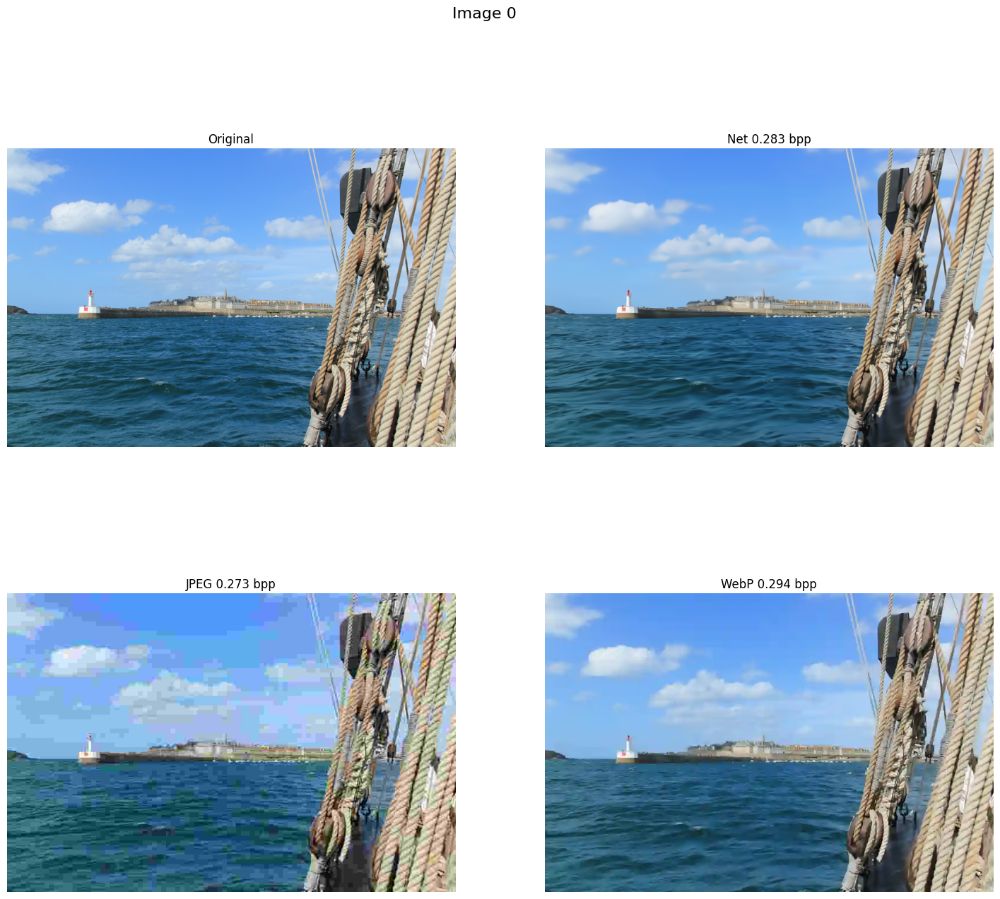

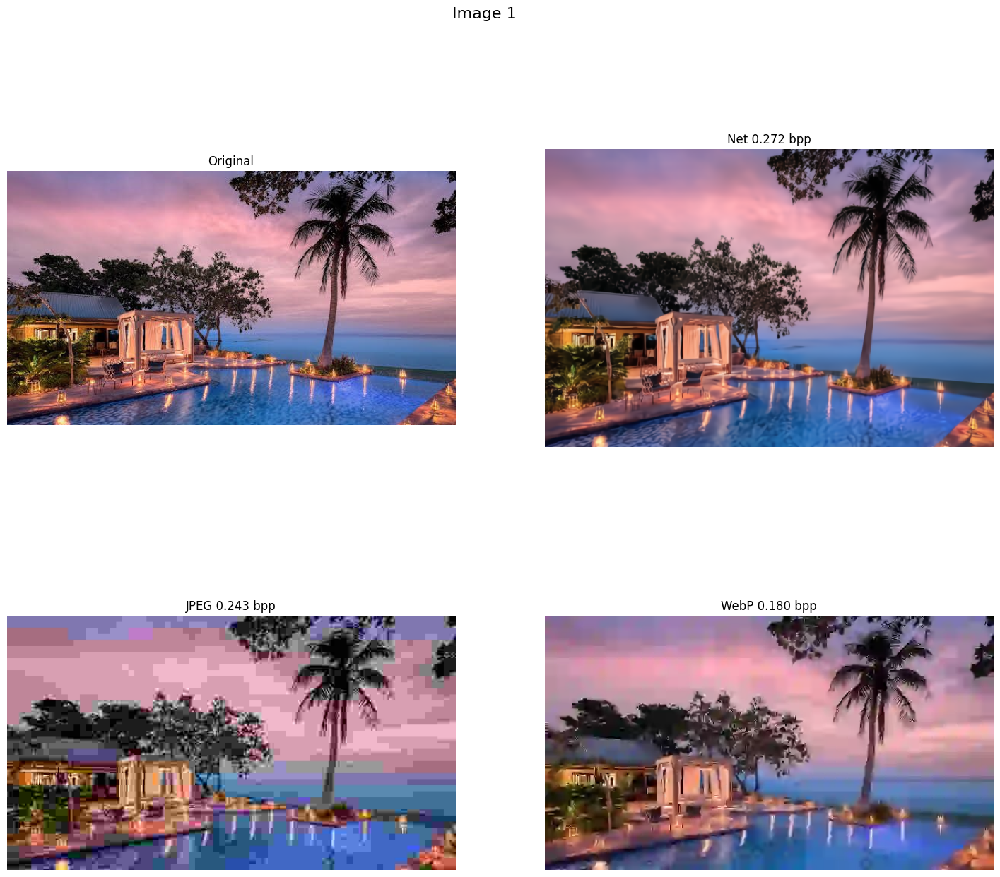

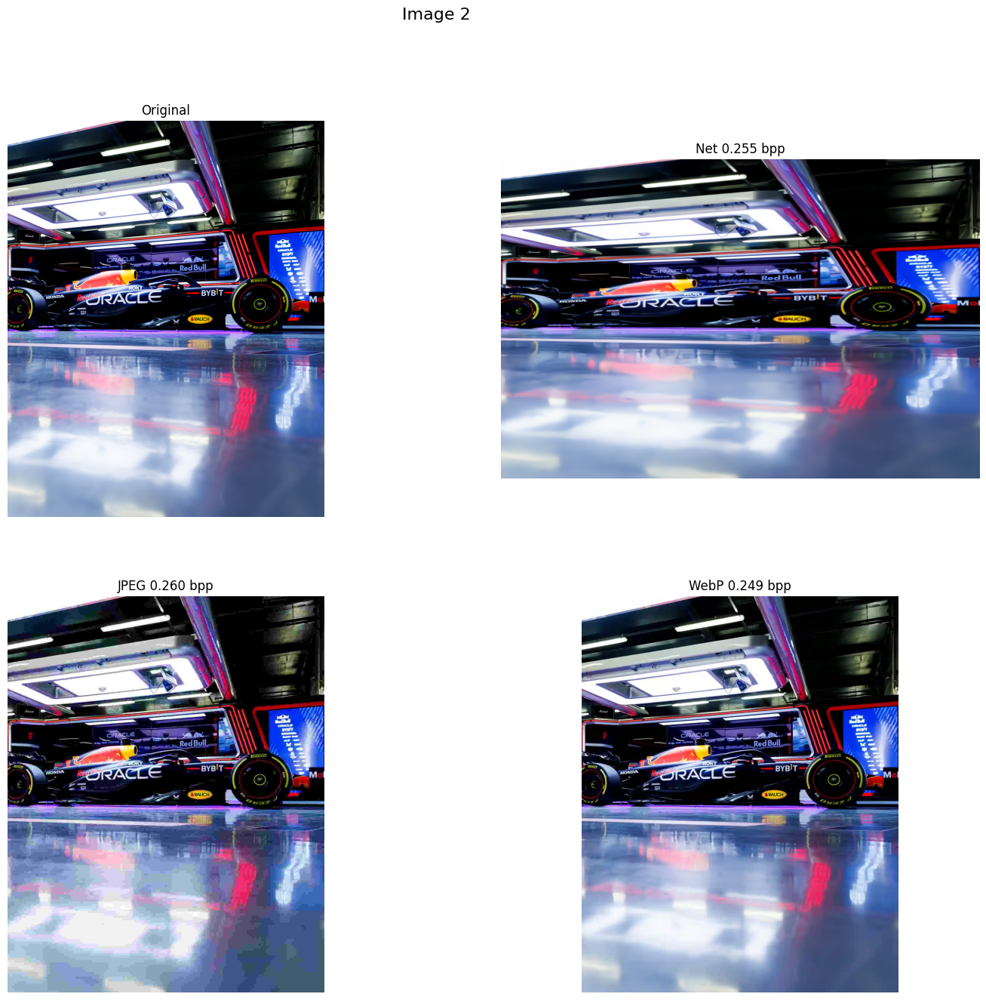

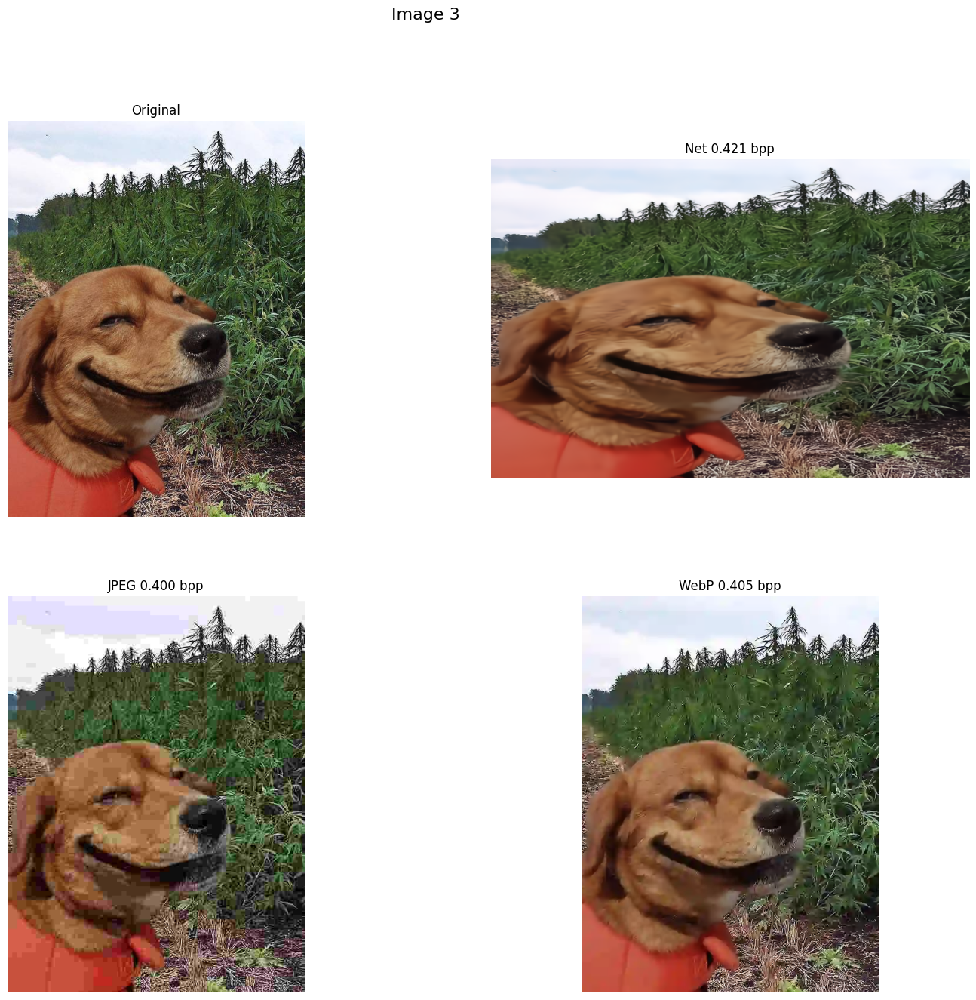

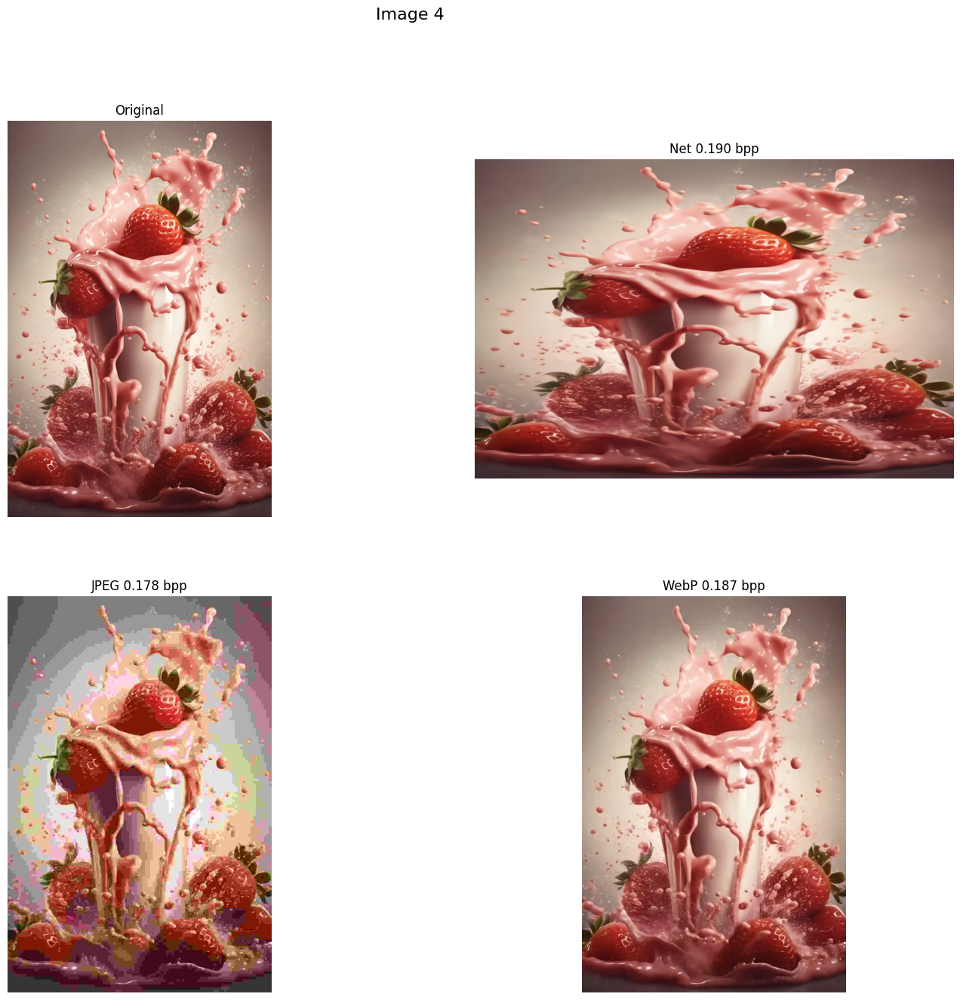

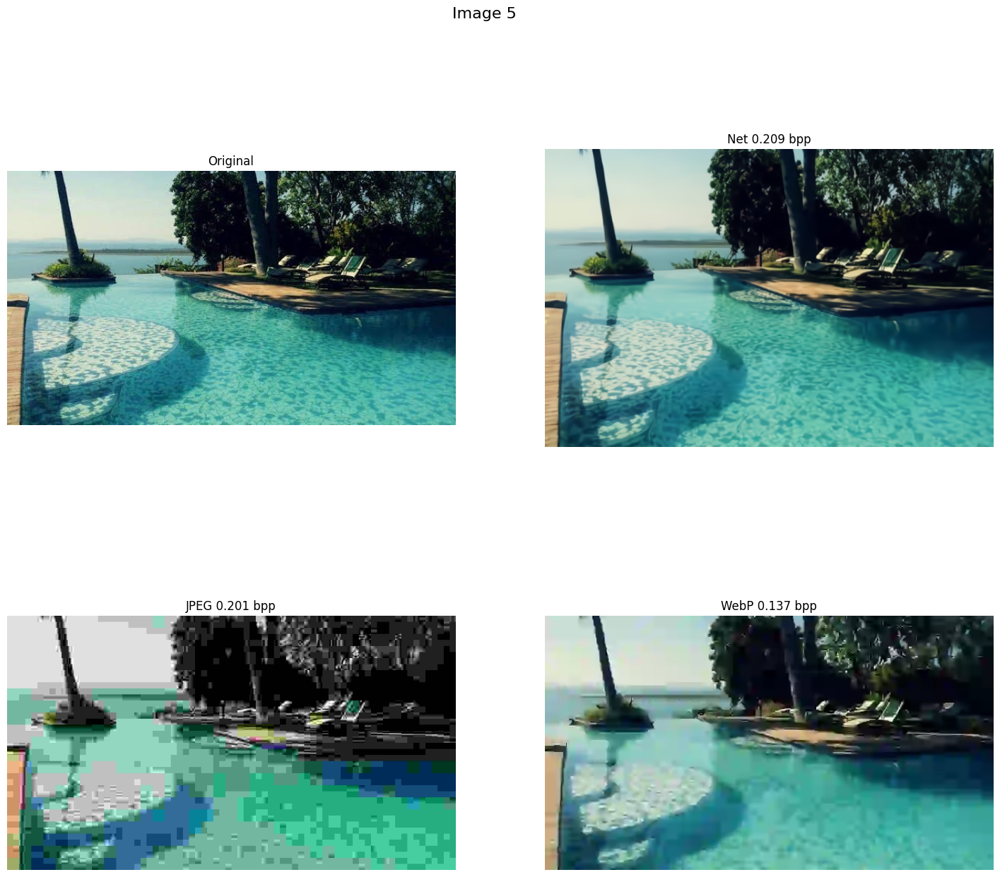

In [115]:
for i, out_net in enumerate(outputs):
    image_path = os.path.join(input_dir, image_files[i])
    img = Image.open(image_path).convert('RGB')
    target_bpp = compute_bpp(out_net)
    rec_jpeg, bpp_jpeg = find_closest_bpp(target_bpp, img)
    rec_webp, bpp_webp = find_closest_bpp(target_bpp, img, fmt='webp')

    fig, axes = plt.subplots(2, 2, figsize=(18, 15))
    for ax in axes.ravel():
        ax.axis('off')

    fig.suptitle(f'Image {i}', fontsize=16)  # Title for the figure

    axes[0][0].imshow(img)
    axes[0][0].title.set_text('Original')

    axes[0][1].imshow(rec_netlist[i])
    axes[0][1].title.set_text(f'Net {target_bpp:.3f} bpp')

    axes[1][0].imshow(rec_jpeg)
    axes[1][0].title.set_text(f'JPEG {bpp_jpeg:.3f} bpp')

    axes[1][1].imshow(rec_webp)
    axes[1][1].title.set_text(f'WebP {bpp_webp:.3f} bpp')

    plt.show()


## ***Bit-rate comparison at similar PSNR***

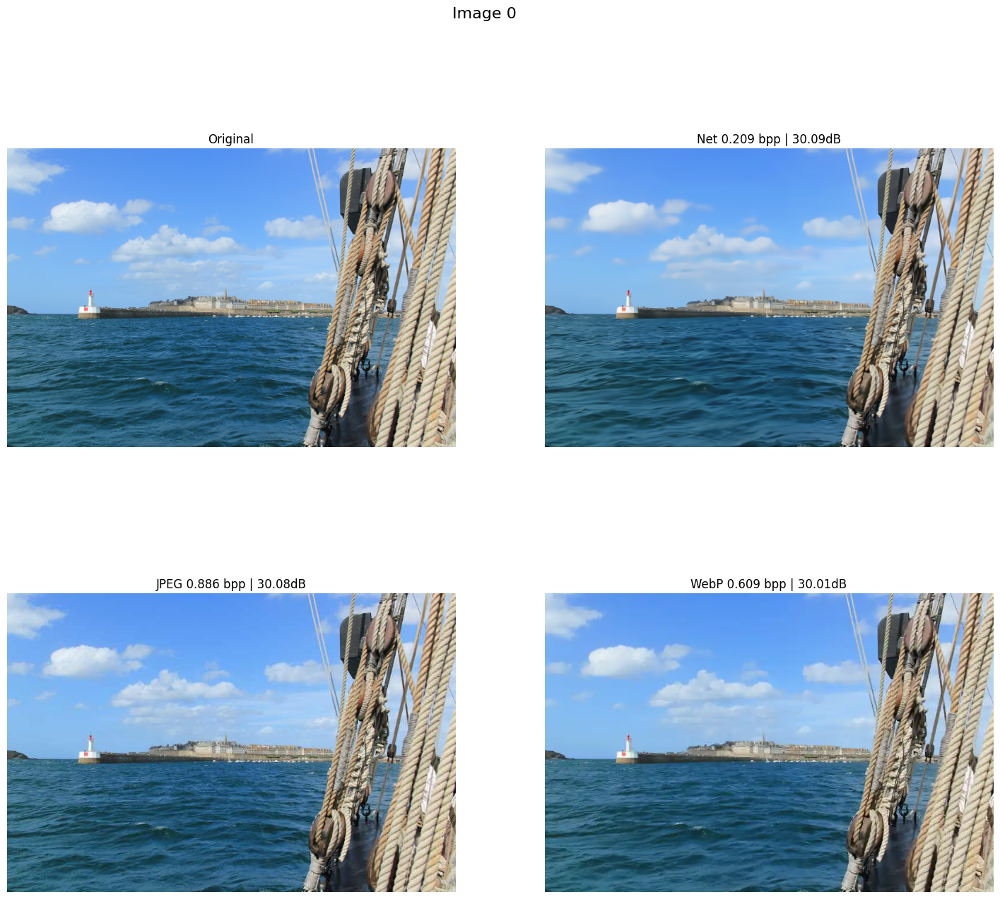

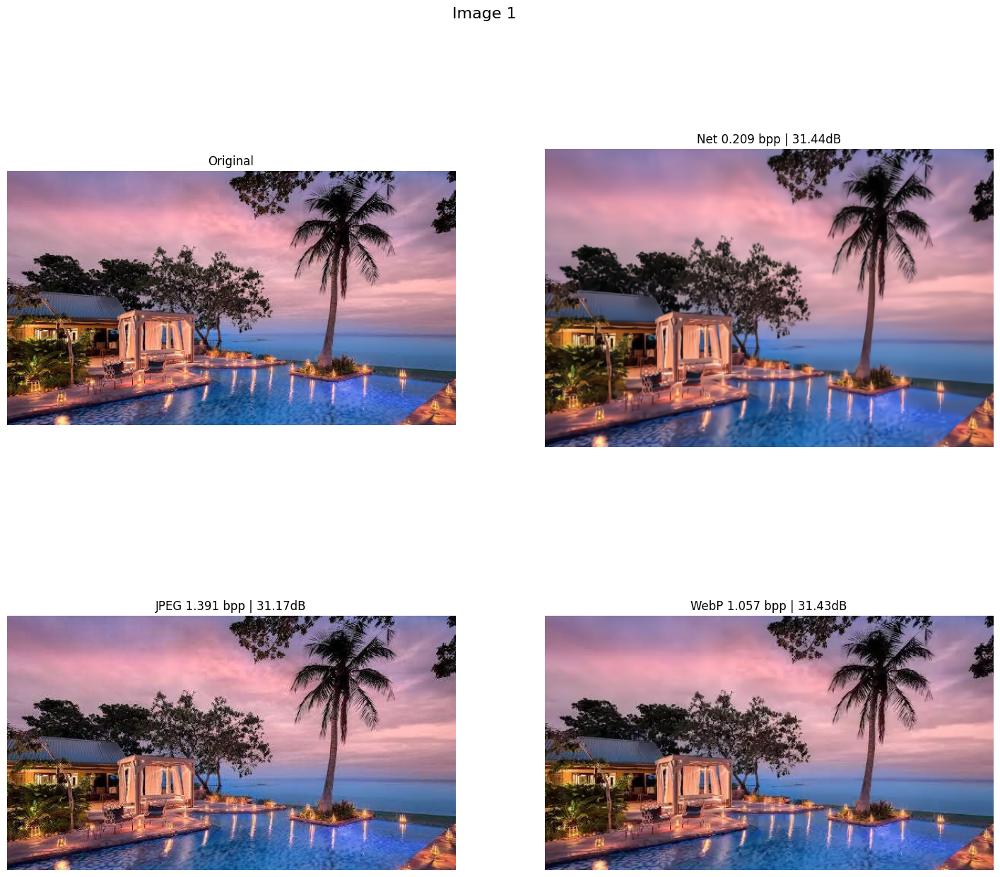

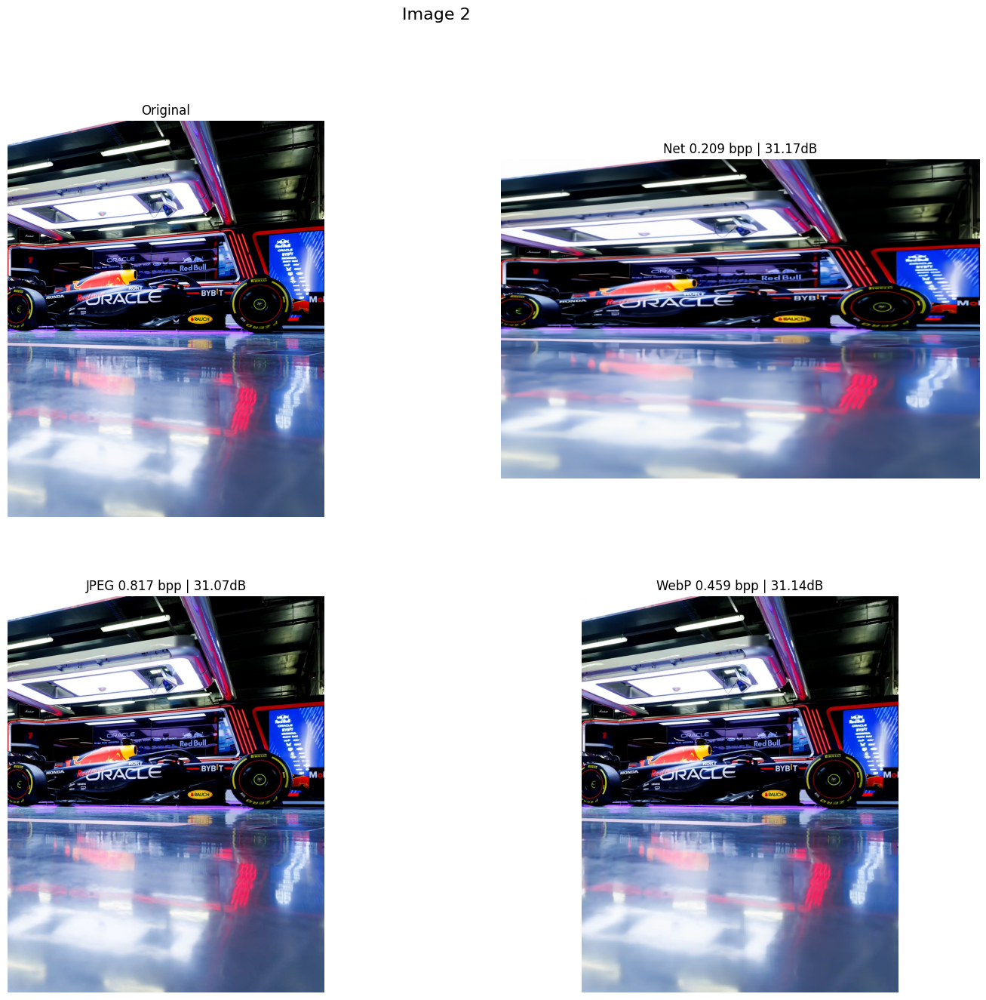

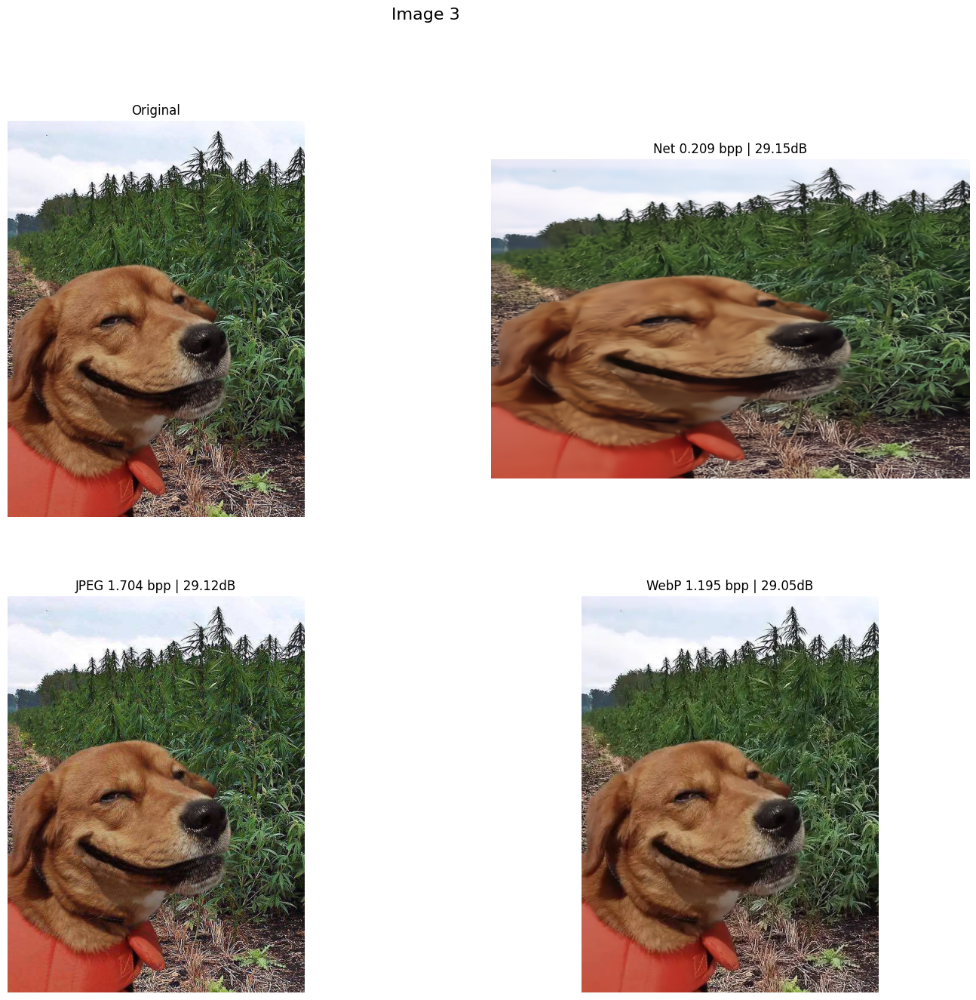

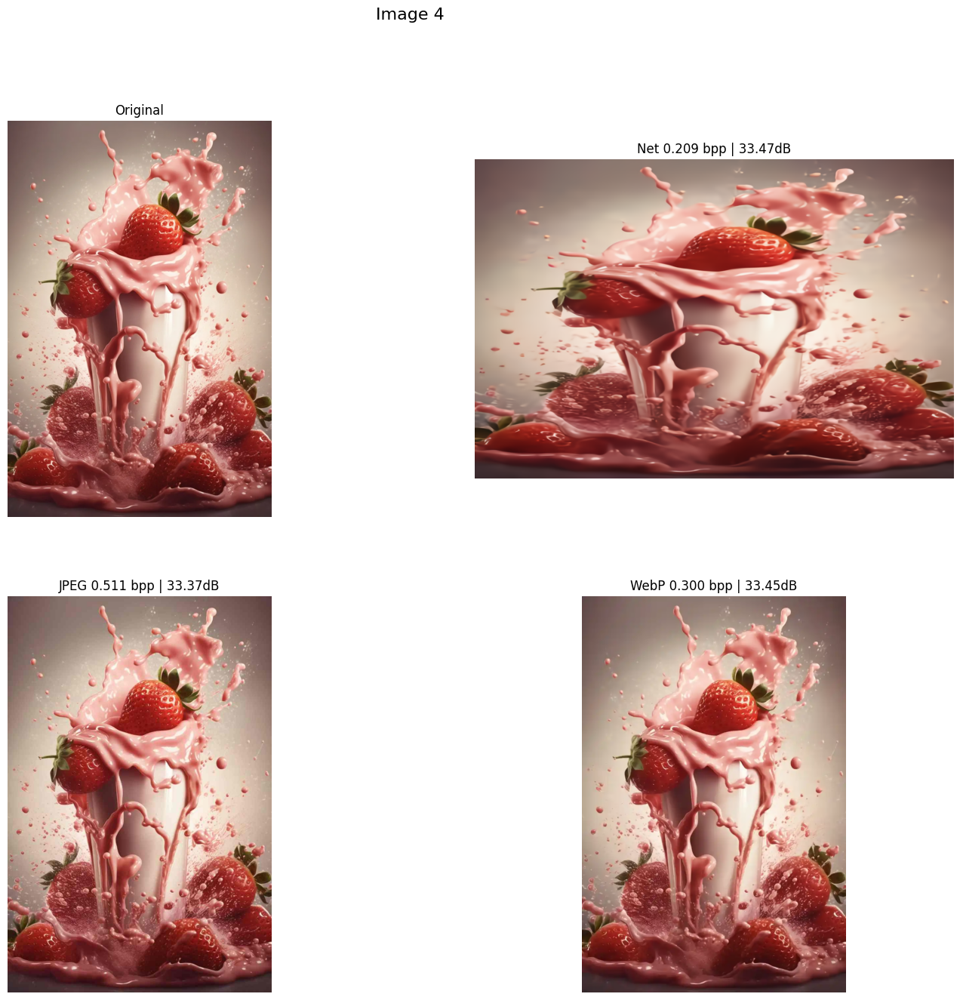

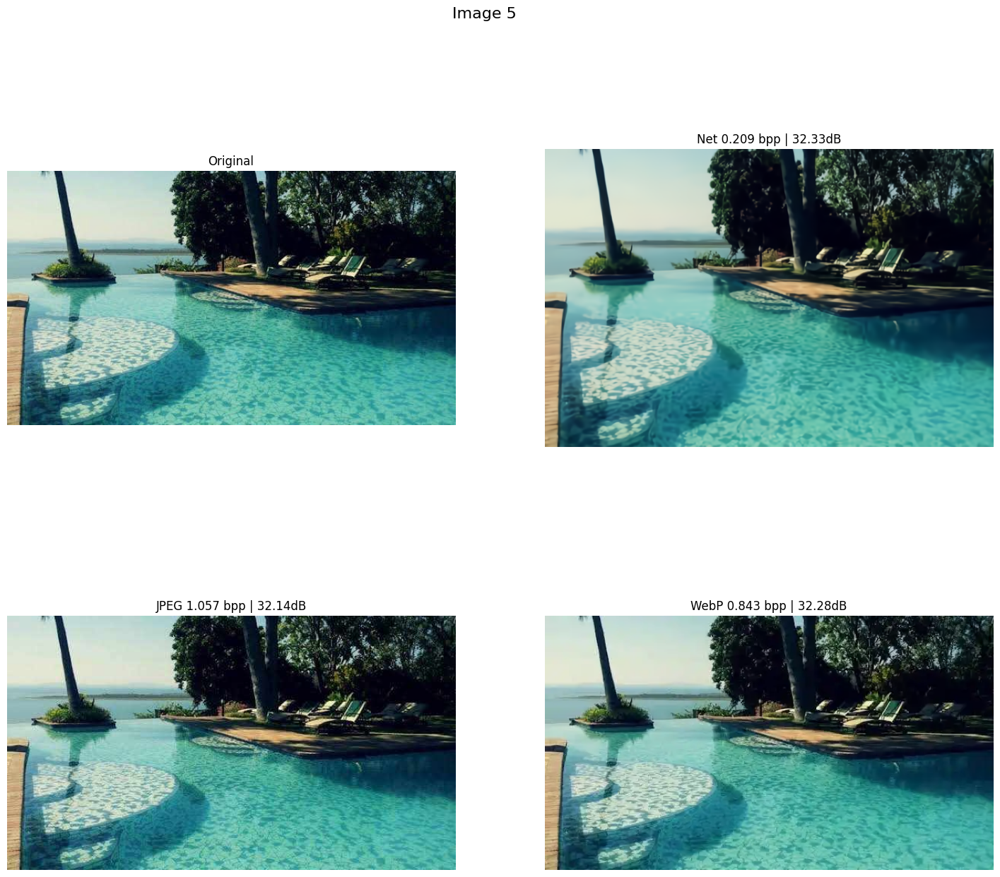

In [116]:
for i, out_net in enumerate(outputs):
    image_path = os.path.join(input_dir, image_files[i])
    img = Image.open(image_path).convert('RGB')

    target_psnr = compute_psnr(image_tensors[i], out_net["x_hat"])
    rec_jpeg, bpp_jpeg, psnr_jpeg = find_closest_psnr(target_psnr, img)
    rec_webp, bpp_webp, psnr_webp = find_closest_psnr(target_psnr, img, fmt='webp')

    fig, axes = plt.subplots(2, 2, figsize=(18, 15))
    for ax in axes.ravel():
        ax.axis('off')

    fig.suptitle(f'Image {i}', fontsize=16)  # Title for the figure

    axes[0][0].imshow(img)
    axes[0][0].title.set_text('Original')

    axes[0][1].imshow(rec_netlist[i])
    axes[0][1].title.set_text(f'Net {target_bpp:.3f} bpp | {target_psnr:.2f}dB')
    axes[1][0].imshow(rec_jpeg)
    axes[1][0].title.set_text(f'JPEG {bpp_jpeg:.3f} bpp | {psnr_jpeg:.2f}dB')
    axes[1][1].imshow(rec_webp)
    axes[1][1].title.set_text(f'WebP {bpp_webp:.3f} bpp | {psnr_webp:.2f}dB')

    plt.show()

## **Bit-rate comparison at similar MS-SSIM***

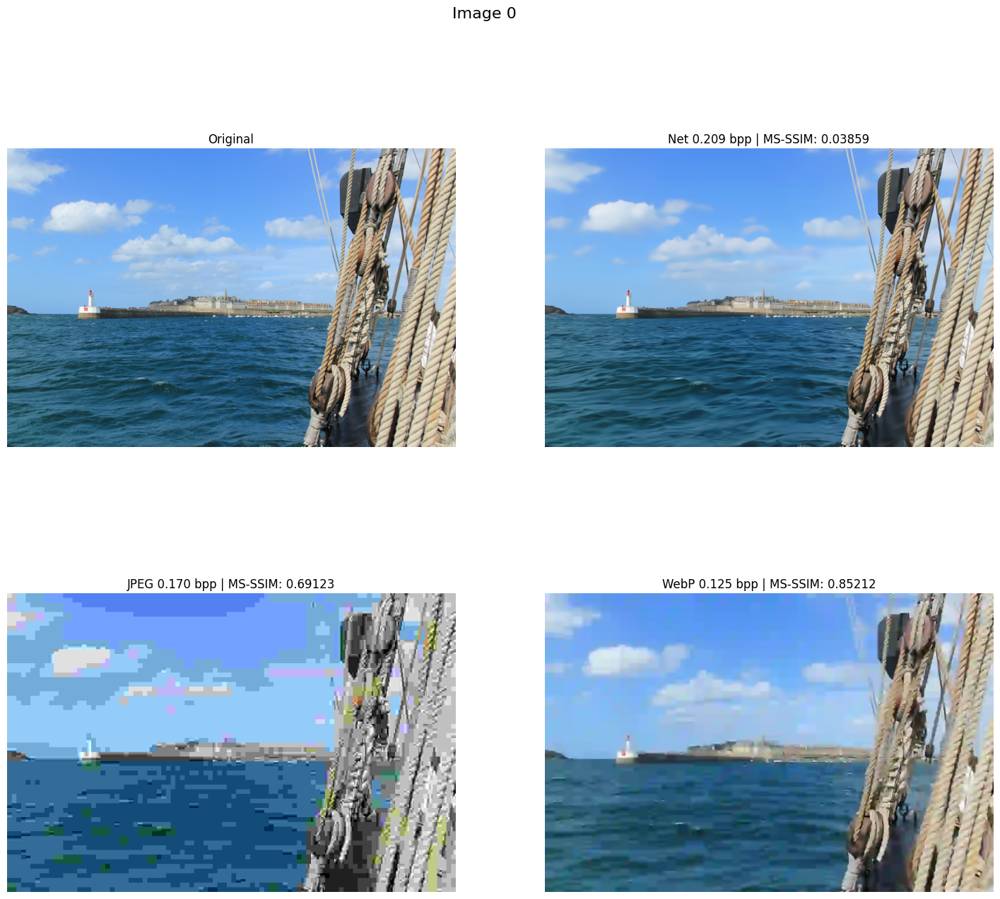

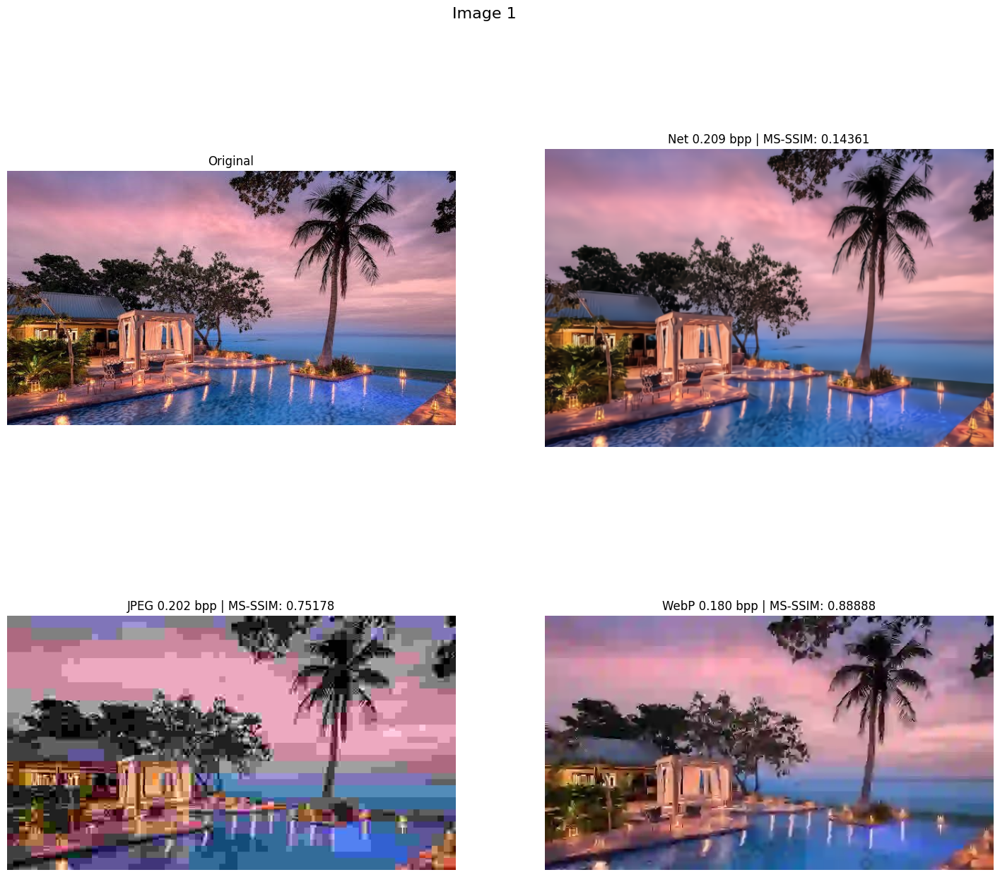

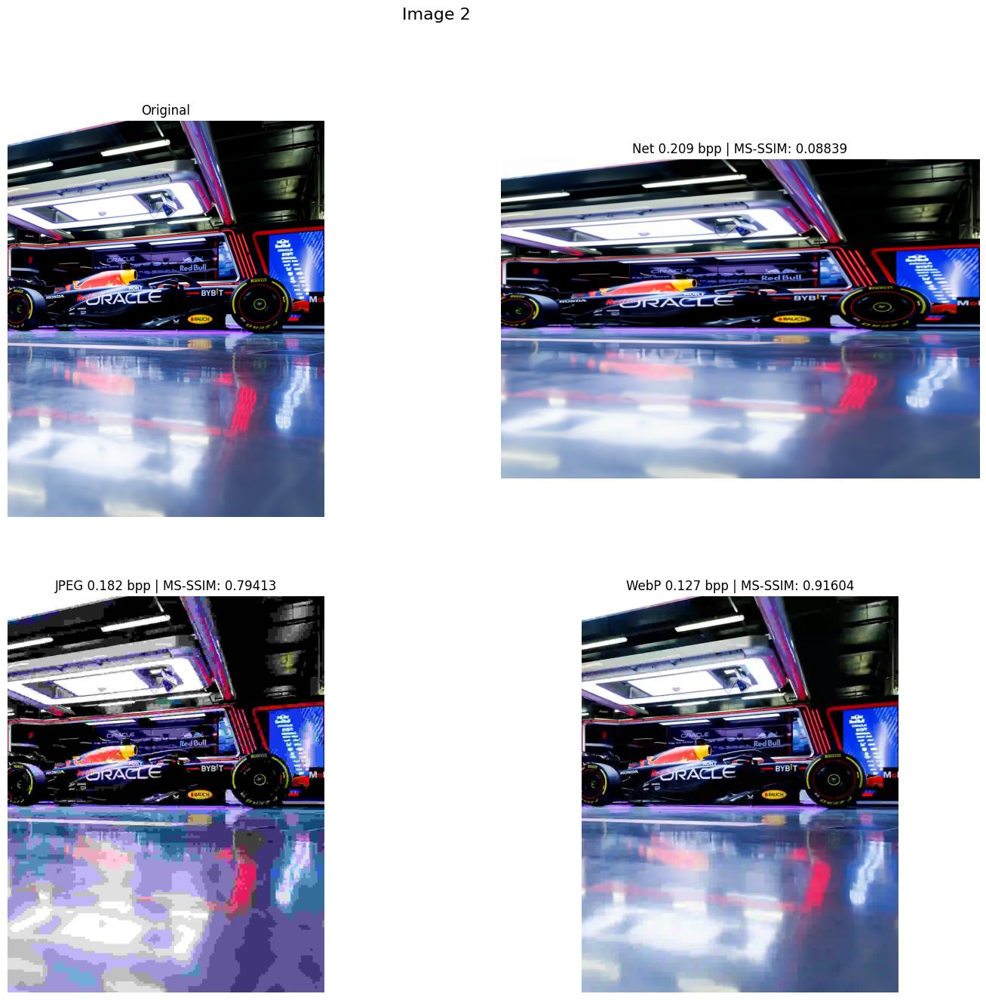

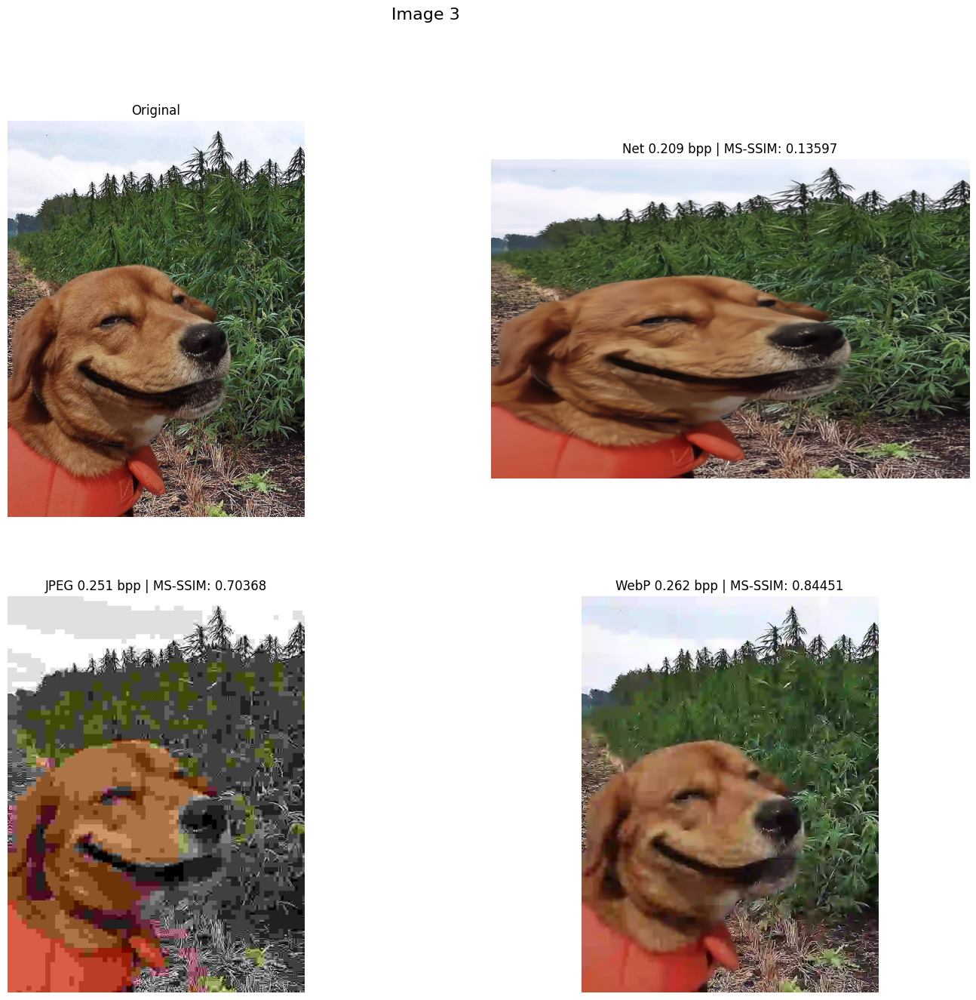

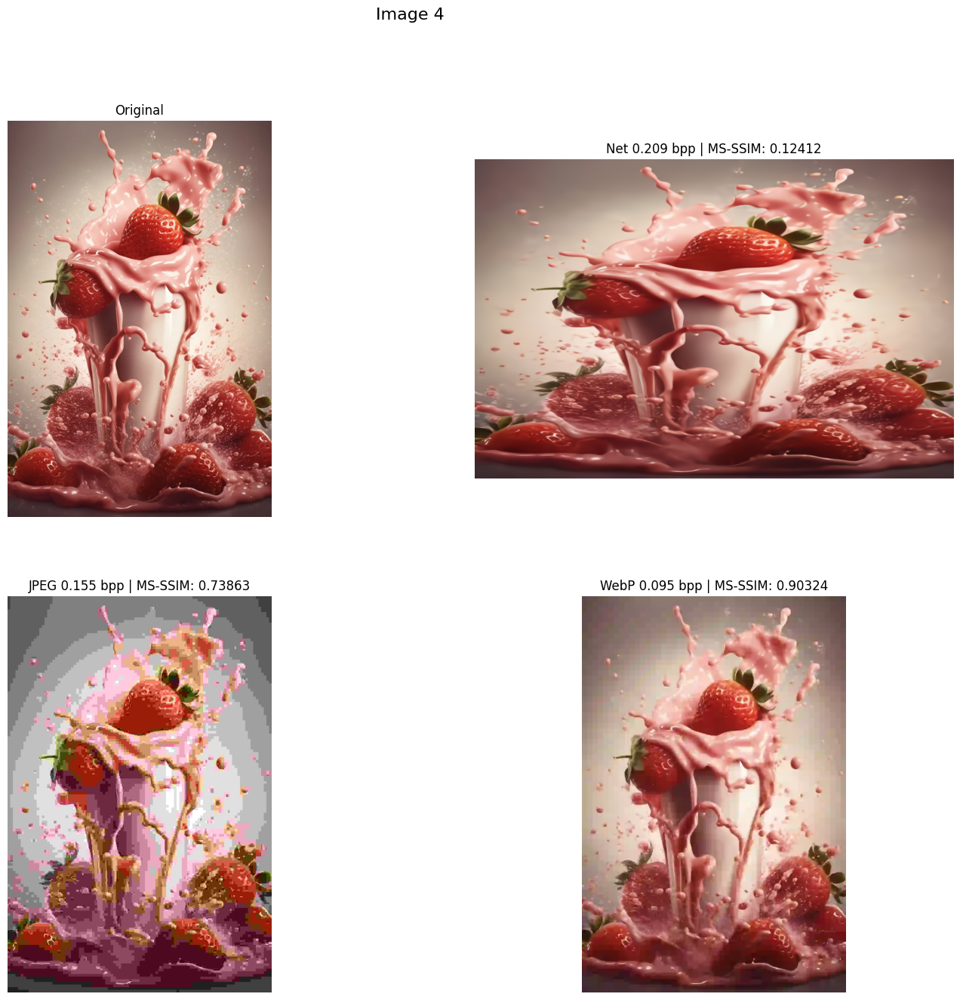

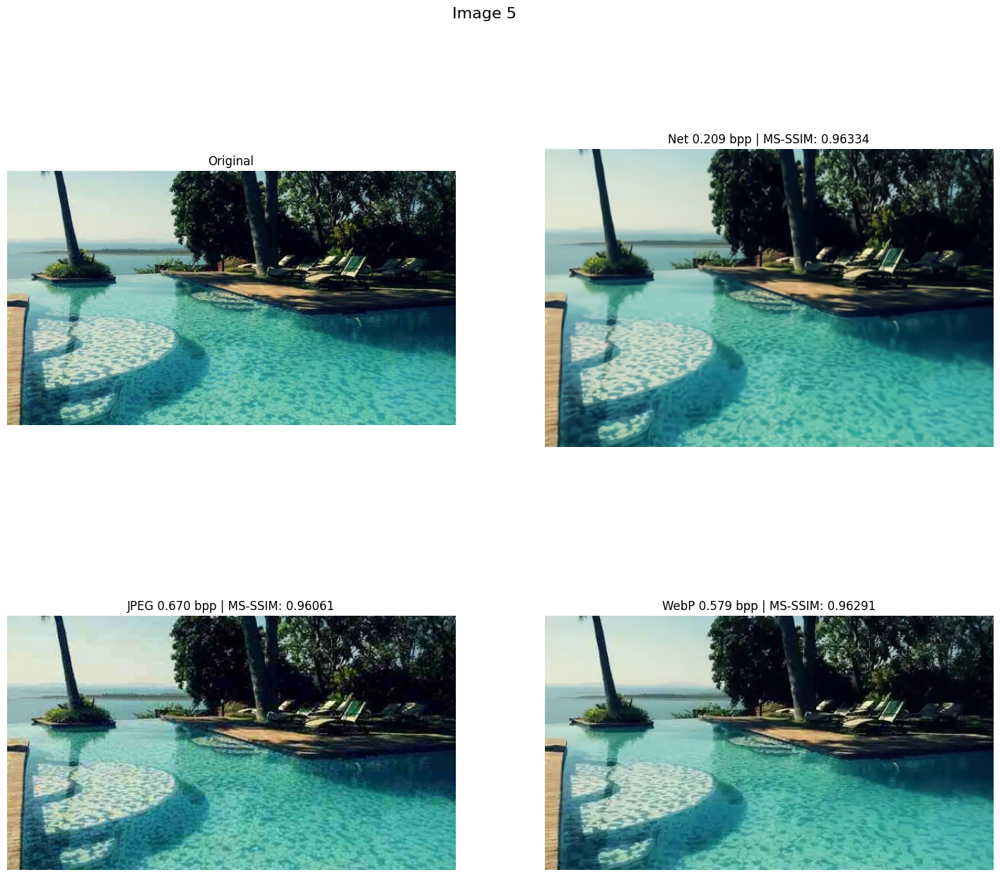

In [117]:
for i, out_net in enumerate(outputs):
    image_path = os.path.join(input_dir, image_files[i])
    img = Image.open(image_path).convert('RGB')

    target_msssim = compute_msssim(x, out_net["x_hat"])
    rec_jpeg, bpp_jpeg, msssim_jpeg = find_closest_msssim(target_msssim, img)
    rec_webp, bpp_webp, msssim_webp = find_closest_msssim(target_msssim, img, fmt='webp')

    fig, axes = plt.subplots(2, 2, figsize=(18, 15))
    for ax in axes.ravel():
        ax.axis('off')

    fig.suptitle(f'Image {i}', fontsize=16)  # Title for the figure

    axes[0][0].imshow(img)
    axes[0][0].title.set_text('Original')

    axes[0][1].imshow(rec_netlist[i])
    axes[0][1].title.set_text(f'Net {target_bpp:.3f} bpp | MS-SSIM: {target_msssim:.5f}')
    axes[1][0].imshow(rec_jpeg)
    axes[1][0].title.set_text(f'JPEG {bpp_jpeg:.3f} bpp | MS-SSIM: {msssim_jpeg:.5f}')
    axes[1][1].imshow(rec_webp)
    axes[1][1].title.set_text(f'WebP {bpp_webp:.3f} bpp | MS-SSIM: {msssim_webp:.5f}')

    plt.show()

## **Latent visualization**
Per-latent bit-rate results

In [119]:
def detailed_bpp(out):
    size = out['x_hat'].size()
    num_pixels = size[0] * size[2] * size[3]
    for name, values in out_net['likelihoods'].items():
        bpp_val = torch.log(values).sum() / (-math.log(2) * num_pixels)
        print(f'- "{name}" latent bit-rate: {bpp_val:.3f} bpp')


for i, out_net in enumerate(outputs):
    print(f'\t\t\t\t Detailed bpp for image {i+1}:')
    detailed_bpp(out_net)
    with torch.no_grad():
        x = image_tensors[i]
        y = net.g_a(x)
        y_hat, y_likelihoods = net.entropy_bottleneck(y)
        print(y.size(), y_likelihoods.size())
    print(f'{"*"*83}\n\n')

				 Detailed bpp for image 1:
- "y" latent bit-rate: 0.281 bpp
- "z" latent bit-rate: 0.001 bpp
torch.Size([1, 128, 32, 48]) torch.Size([1, 128, 32, 48])
***********************************************************************************


				 Detailed bpp for image 2:
- "y" latent bit-rate: 0.271 bpp
- "z" latent bit-rate: 0.001 bpp
torch.Size([1, 128, 32, 48]) torch.Size([1, 128, 32, 48])
***********************************************************************************


				 Detailed bpp for image 3:
- "y" latent bit-rate: 0.253 bpp
- "z" latent bit-rate: 0.002 bpp
torch.Size([1, 128, 32, 48]) torch.Size([1, 128, 32, 48])
***********************************************************************************


				 Detailed bpp for image 4:
- "y" latent bit-rate: 0.419 bpp
- "z" latent bit-rate: 0.002 bpp
torch.Size([1, 128, 32, 48]) torch.Size([1, 128, 32, 48])
***********************************************************************************


				 Detailed bpp for image 5:
- "y"

## ***Per channel estimated bit-rate***

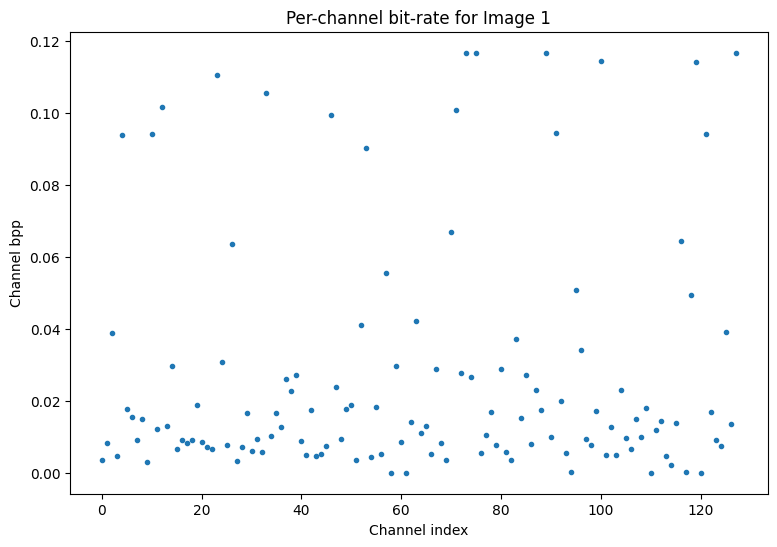

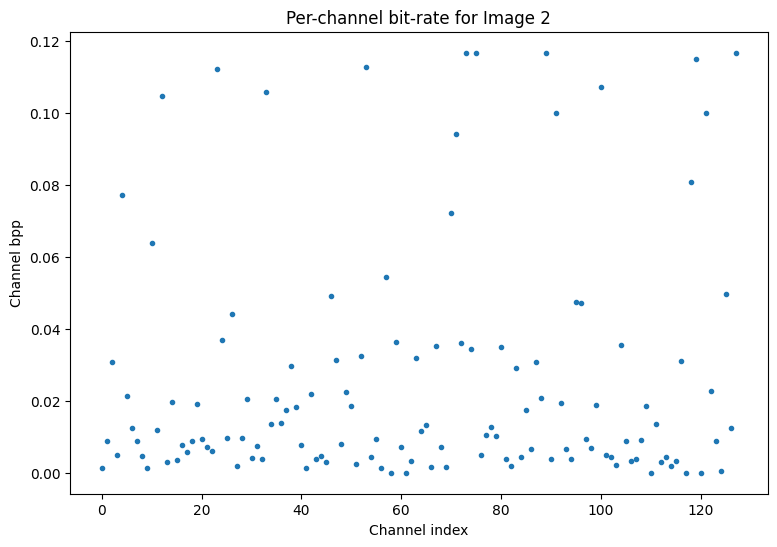

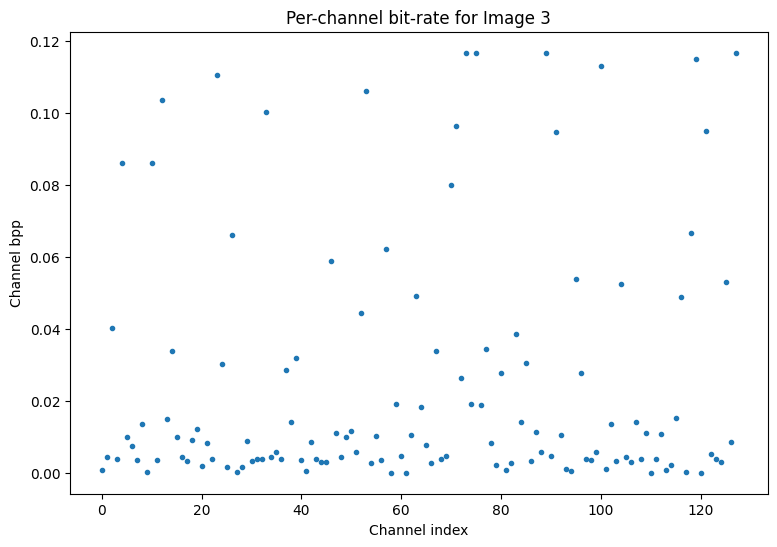

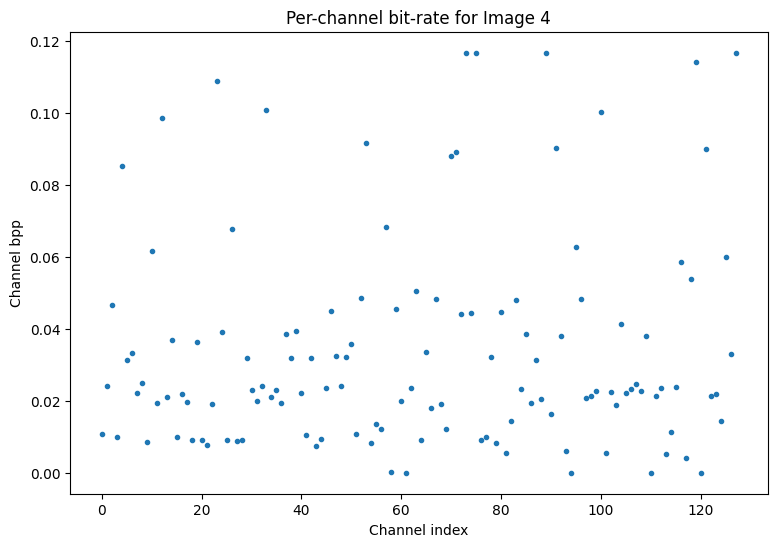

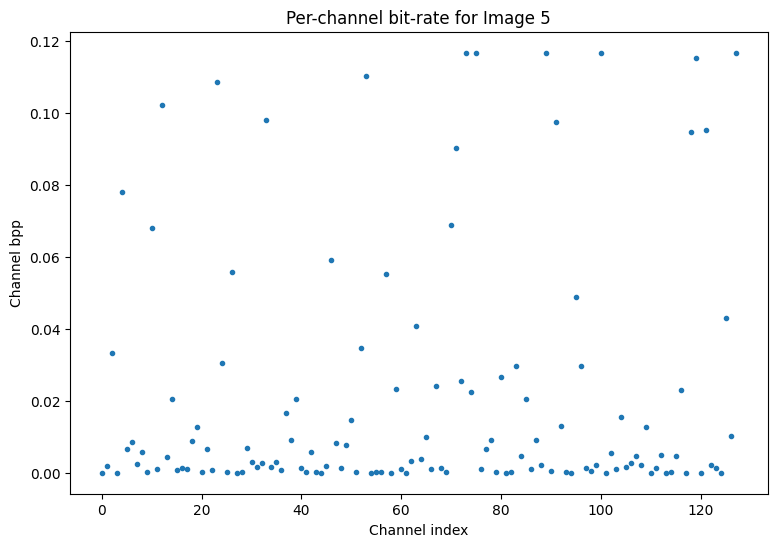

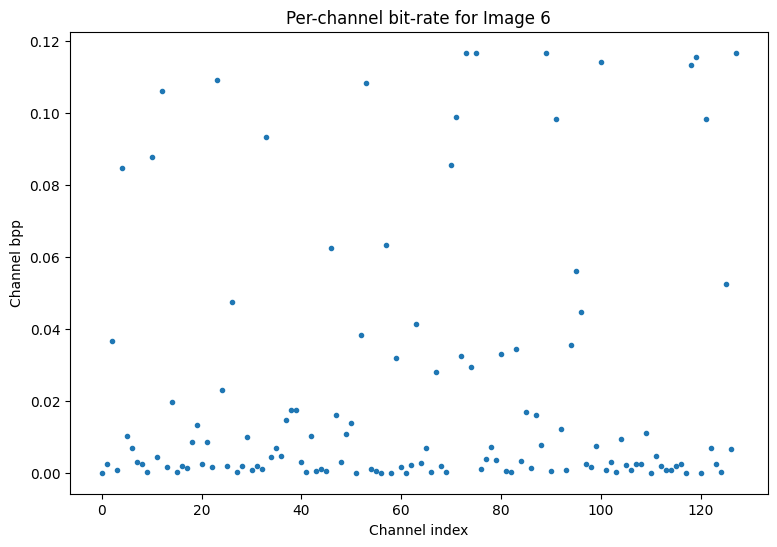

In [120]:
%matplotlib inline

def plot_channel_bpps(x, y, y_likelihoods, image_index):
    num_pixels = x.size(2) * x.size(3)

    channel_bpps = [torch.log(y_likelihoods[0, c]).sum().item() / (-math.log(2) * num_pixels)
                    for c in range(y.size(1))]

    fig, ax = plt.subplots(figsize=(9, 6))
    ax.plot(channel_bpps, '.')
    ax.title.set_text(f'Per-channel bit-rate for Image {image_index}')
    ax.set_xlabel('Channel index')
    ax.set_ylabel('Channel bpp')
    plt.show()

for i, out_net in enumerate(outputs):
    with torch.no_grad():
        x = image_tensors[i]
        y = net.g_a(x)
        y_hat, y_likelihoods = net.entropy_bottleneck(y)

    plot_channel_bpps(x, y, y_likelihoods, i + 1)

## ***Order channels by bit-rates***

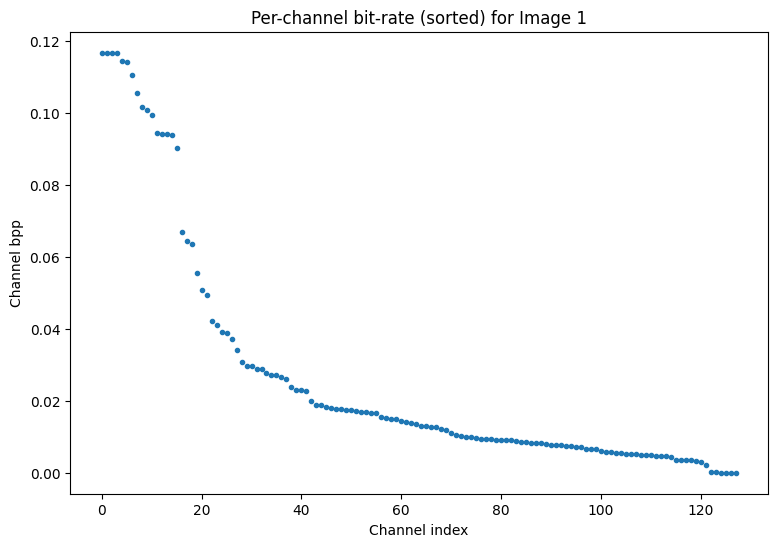

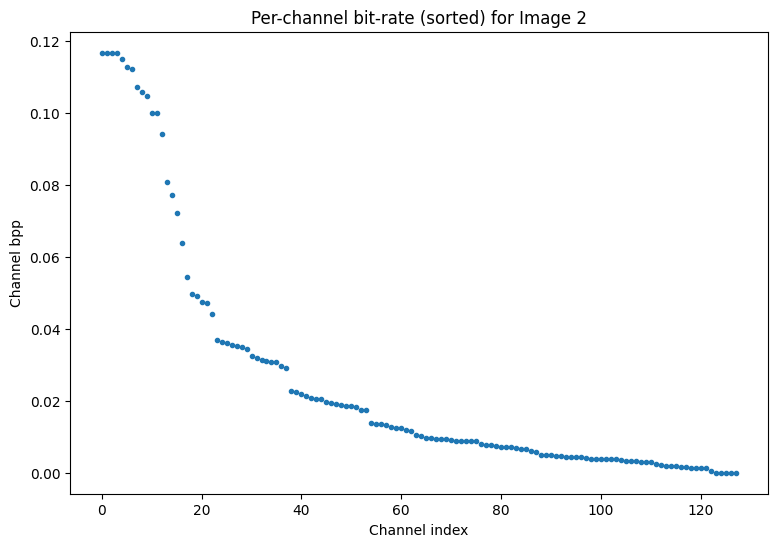

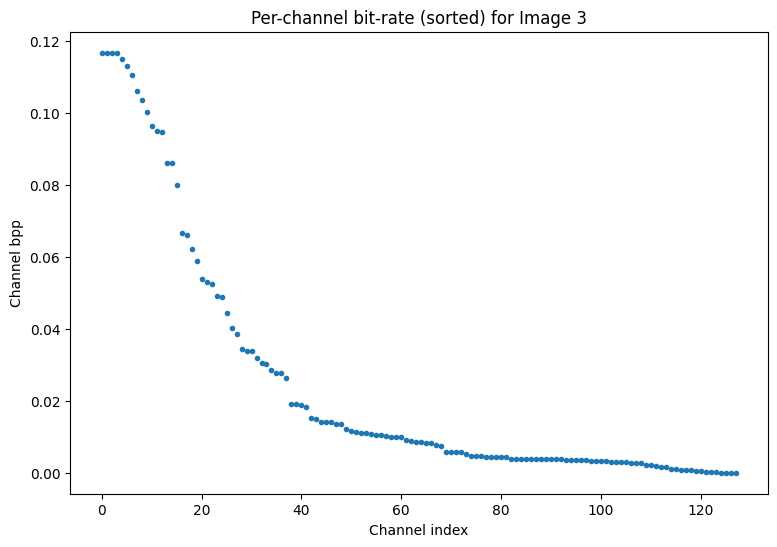

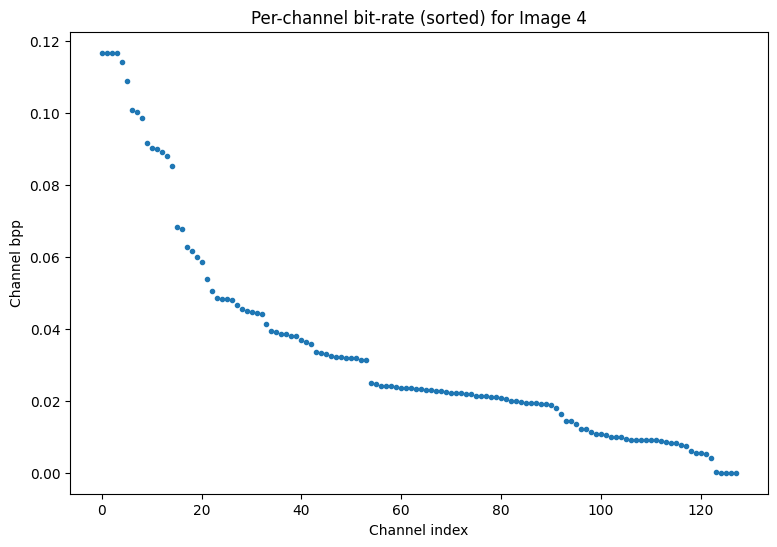

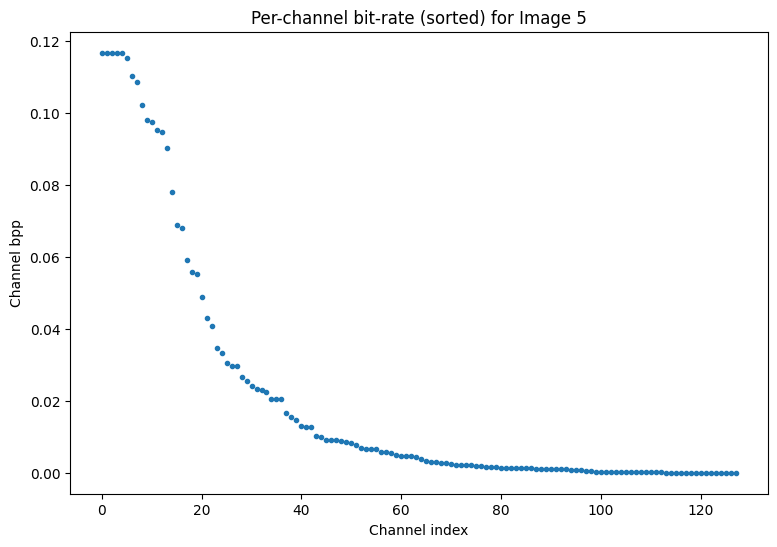

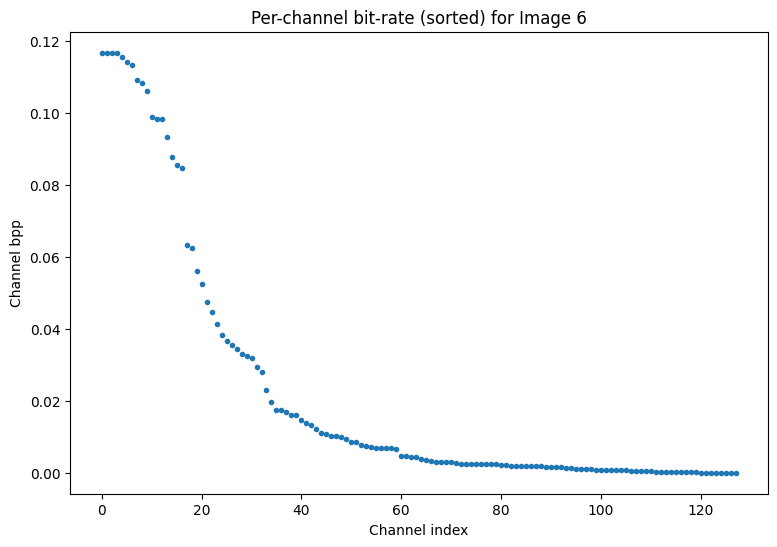

In [121]:
%matplotlib inline

def plot_sorted_channel_bpps(channel_bpps, image_index):
    ordered_idxs = torch.argsort(torch.Tensor(channel_bpps), descending=True)
    ordered_channel_bpps = torch.Tensor(channel_bpps)[ordered_idxs]

    fig, ax = plt.subplots(figsize=(9, 6))
    ax.plot(ordered_channel_bpps, '.')
    ax.title.set_text(f'Per-channel bit-rate (sorted) for Image {image_index}')
    ax.set_xlabel('Channel index')
    ax.set_ylabel('Channel bpp')
    plt.show()

for i, out_net in enumerate(outputs):
    with torch.no_grad():
        x = image_tensors[i]
        y = net.g_a(x)
        y_hat, y_likelihoods = net.entropy_bottleneck(y)

    num_pixels = x.size(2) * x.size(3)
    channel_bpps = [torch.log(y_likelihoods[0, c]).sum().item() / (-math.log(2) * num_pixels)
                    for c in range(y.size(1))]

    plot_sorted_channel_bpps(channel_bpps, i + 1)  # i + 1 to show 1-indexed image numbers

## ***Interactive per-channel visualization***

In [122]:
from IPython.display import display, clear_output

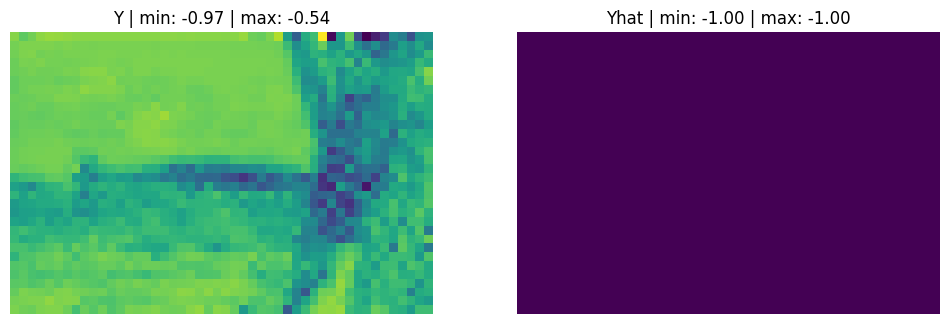

In [123]:
%matplotlib inline

fig, axes = plt.subplots(1, 2, figsize=(12, 9))
for ax in axes:
    ax.axis('off')

out = widgets.Output()

def show_channel(img_idx, c):
    with torch.no_grad():
        x = image_tensors[img_idx]
        y = net.g_a(x)
        y_hat, y_likelihoods = net.entropy_bottleneck(y)

    num_pixels = x.size(2) * x.size(3)
    channel_bpps = [torch.log(y_likelihoods[0, c]).sum().item() / (-math.log(2) * num_pixels)
                    for c in range(y.size(1))]
    ordered_idxs = torch.argsort(torch.Tensor(channel_bpps), descending=True)

    channel = y[0, ordered_idxs[c]].cpu()
    axes[0].imshow(channel)
    axes[0].title.set_text(f'Y | min: {channel.min():.2f} | max: {channel.max():.2f}')

    channel = y_hat[0, ordered_idxs[c]].cpu()
    axes[1].imshow(channel)
    axes[1].title.set_text(f'Yhat | min: {channel.min():.2f} | max: {channel.max():.2f}')

    with out:
        clear_output(wait=True)
        display(fig)

img_slider = widgets.IntSlider(min=0, max=len(image_tensors)-1, step=1, continuous_update=False, description='Image idx')
channel_slider = widgets.IntSlider(min=0, max=y.size(1)-1, step=1, continuous_update=False, description='Channel idx')

def update(ev):
    show_channel(img_slider.value, channel_slider.value)

img_slider.observe(update)
channel_slider.observe(update)

show_channel(0, 0)
display(widgets.VBox([out, img_slider, channel_slider]))

## **Quantized vs continuous latent**

Image 1:
Decoded continuous latent:
PSNR: 31.36dB
MS-SSIM: 0.9804

Decoded quantized latent:
PSNR: 30.10dB
MS-SSIM: 0.9720



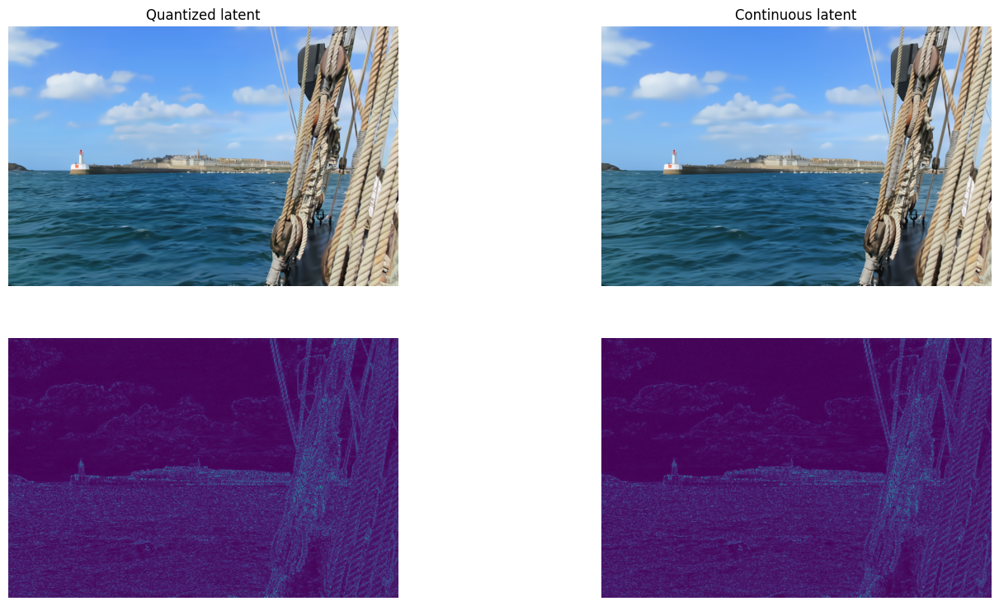

Image 2:
Decoded continuous latent:
PSNR: 33.33dB
MS-SSIM: 0.9816

Decoded quantized latent:
PSNR: 31.53dB
MS-SSIM: 0.9752



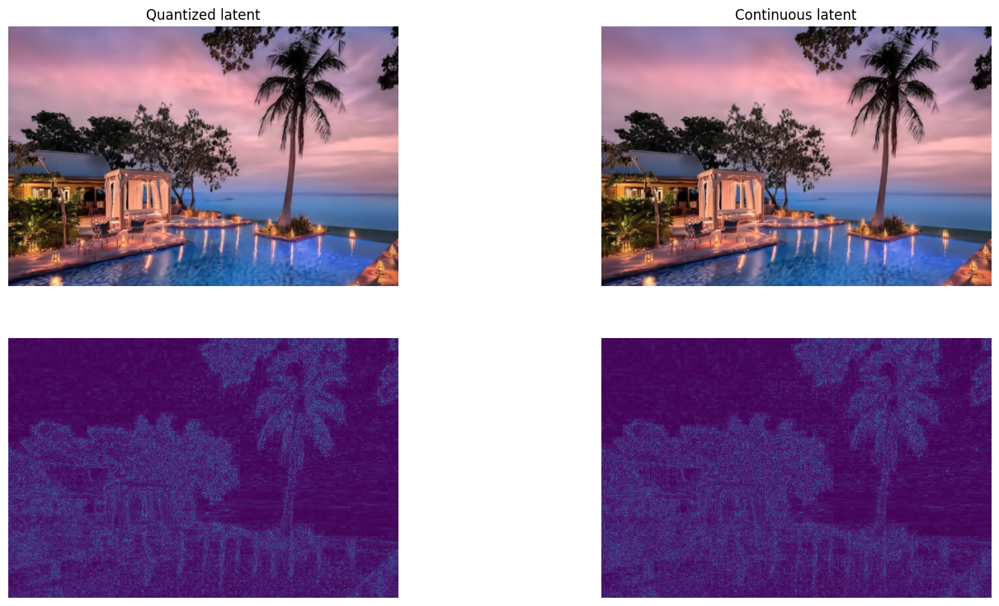

Image 3:
Decoded continuous latent:
PSNR: 32.40dB
MS-SSIM: 0.9877

Decoded quantized latent:
PSNR: 31.18dB
MS-SSIM: 0.9838



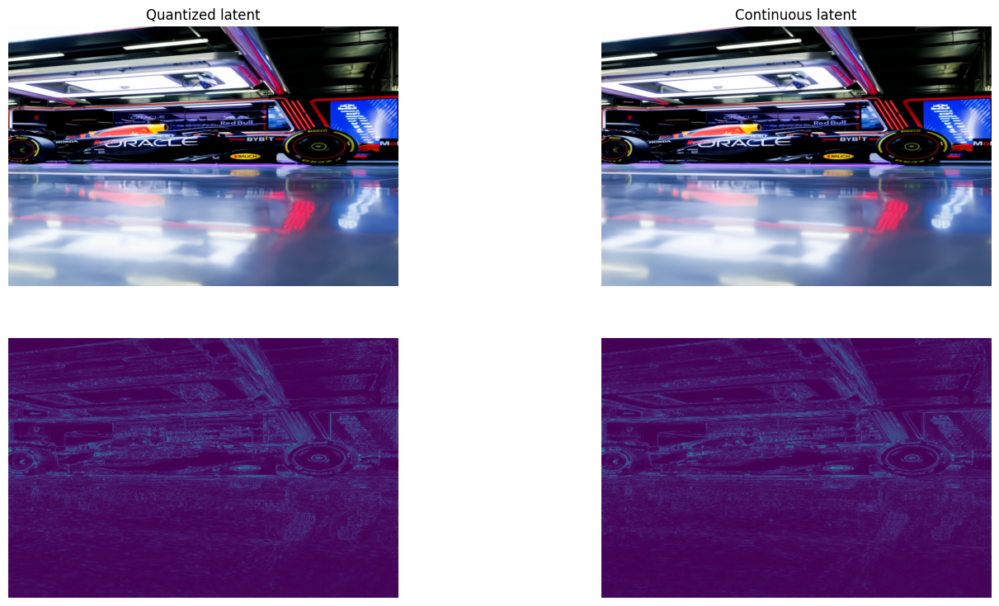

Image 4:
Decoded continuous latent:
PSNR: 30.67dB
MS-SSIM: 0.9778

Decoded quantized latent:
PSNR: 29.19dB
MS-SSIM: 0.9670



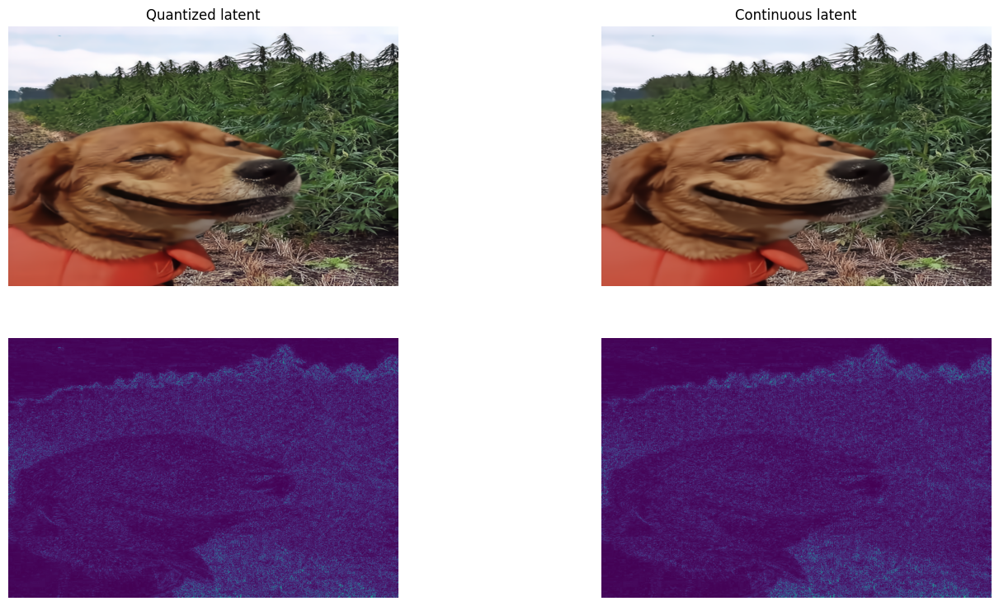

Image 5:
Decoded continuous latent:
PSNR: 35.43dB
MS-SSIM: 0.9841

Decoded quantized latent:
PSNR: 33.54dB
MS-SSIM: 0.9781



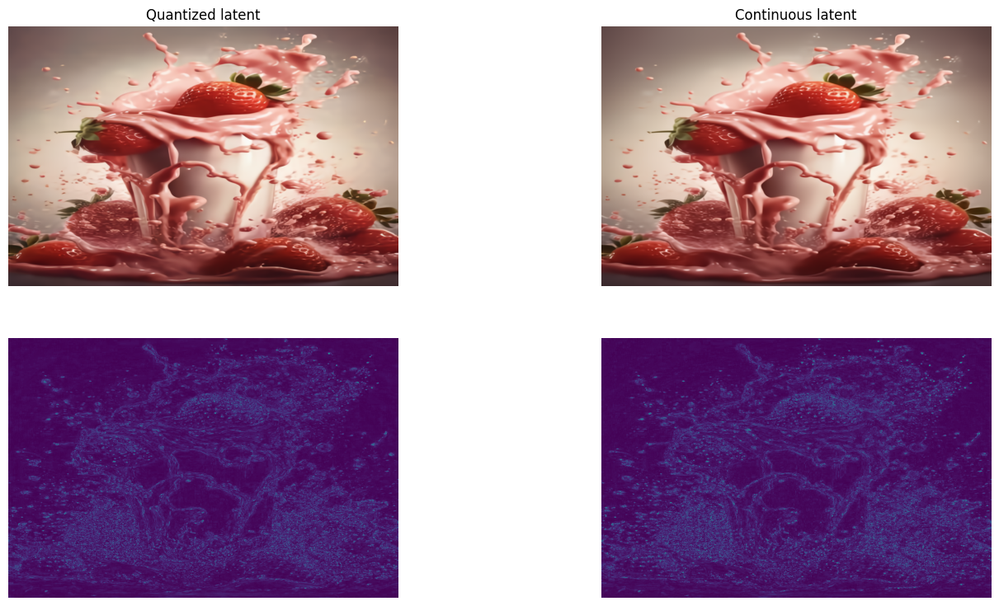

Image 6:
Decoded continuous latent:
PSNR: 34.01dB
MS-SSIM: 0.9731

Decoded quantized latent:
PSNR: 32.49dB
MS-SSIM: 0.9645



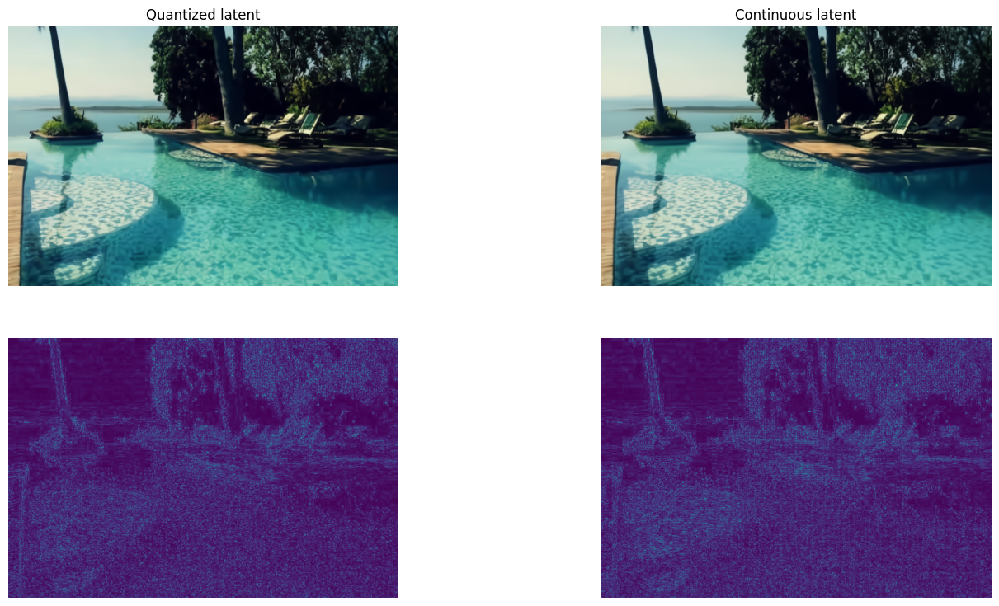

In [124]:
%matplotlib inline

def display_decoded(images, index):
    x = images[index]
    with torch.no_grad():
        y = net.g_a(x)
        y_hat, y_likelihoods = net.entropy_bottleneck(y)
        x_hat_y = net.g_s(y).clamp_(0, 1)
        x_hat_y_hat = net.g_s(y_hat).clamp_(0, 1)

    print(f'Image {index + 1}:')
    print('Decoded continuous latent:')
    print(f'PSNR: {compute_psnr(x, x_hat_y):.2f}dB')
    print(f'MS-SSIM: {compute_msssim(x, x_hat_y):.4f}')
    print()
    print('Decoded quantized latent:')
    print(f'PSNR: {compute_psnr(x, x_hat_y_hat):.2f}dB')
    print(f'MS-SSIM: {compute_msssim(x, x_hat_y_hat):.4f}')
    print()

    fig, axes = plt.subplots(2, 2, figsize=(17, 9))
    for ax in axes.ravel():
        ax.axis('off')

    axes[0][0].imshow(transforms.ToPILImage()(x_hat_y_hat.squeeze().cpu()))
    axes[0][0].title.set_text('Quantized latent')

    axes[1][0].imshow(torch.mean((x - x_hat_y_hat).abs(), axis=1).squeeze().cpu())

    axes[0][1].imshow(transforms.ToPILImage()(x_hat_y.squeeze()))
    axes[0][1].title.set_text('Continuous latent')

    axes[1][1].imshow(torch.mean((x - x_hat_y).abs(), axis=1).squeeze().cpu())

    plt.show()

for i, image_tensor in enumerate(image_tensors):
    display_decoded(image_tensors, i)